## Processing Ocean Color Imagery

This is flight 20210827_A1 from gulf_stream_surveys.

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing
import math

#import cv2
import numpy as np
import matplotlib.pyplot as plt

#import exiftool
import datetime
from datetime import timedelta


import rasterio

from utils import *
from georeg import *

Define the data directory

In [3]:
data_dir = os.path.join('data', '210828_A1_frontcross1')
data_dir

'data/210828_A1_frontcross1'

In [6]:
! ls data/210828_A1_frontcross1

0000SET  RedEdge  SYNLog-13-16-49_28-08-2021.csv
panel	 sea	  SYNLog-13-16-49_28-08-2021_edit.csv


Grab last 4 characters of the file names, which are the img numbers and sort them

In [7]:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + '/sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)
len(img_fns)

2562

Open up the logs from the aircraft which are much more accurate than the GPS and compas from the Altum

In [8]:
data_dir

'data/210828_A1_frontcross1'

In [9]:
alta_logs = format_alta_logs(data_dir + '/SYNLog-13-16-49_28-08-2021_edit.csv')
alta_logs.head()

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3347: DtypeWarning: Columns (0,1,2,4,5,6,7,9) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Reading,IMU Time,Date,GPS Time,Unnamed: 4,Longitude,Latitude,GPS Height,GPS Course,GPS Pos N,...,Gyro Bias P,Gyro Bias Y,Accel Bias X,Accel Bias Y,Accel Bias Z,Extended Status,5V Alarm,Z Vibration,Checksum,id
dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 13:16:49.000000,44,1.696,20210828,13:16:49,NaN,-747456384,356421856,0.84,6.3,62.64,...,-36.4930,8.9696,0.068,0.099,0.28,0.0,0.0,0.11,245.0,0
2021-08-28 13:16:49.000001,45,1.736,20210828,13:16:49,NaN,-747456384,356421856,0.84,6.3,62.64,...,-36.4857,8.9759,0.068,0.099,0.28,0.0,0.0,0.10,142.0,1
2021-08-28 13:16:49.000002,46,1.776,20210828,13:16:49,NaN,-747456384,356421856,0.84,6.3,62.64,...,-36.4841,8.9762,0.068,0.099,0.28,0.0,0.0,0.11,96.0,2
2021-08-28 13:16:49.000003,47,1.816,20210828,13:16:49,NaN,-747456384,356421856,0.84,6.3,62.64,...,-36.4812,8.9740,0.068,0.099,0.28,0.0,0.0,0.11,200.0,3
2021-08-28 13:16:49.000004,48,1.856,20210828,13:16:49,NaN,-747456384,356421856,0.83,7.2,62.66,...,-36.4794,8.9736,0.068,0.099,0.28,0.0,0.0,0.11,191.0,4


Path to the processed sea images

In [10]:
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

### grab all the image metadata and visualize flight

In [11]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

426

In [12]:
len(alta_logs)/50

445.12

In [13]:
for item in mds:
    utc_time = datetime.datetime.strptime('2021-08-28-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    item['alta_altitude'] = float(alta_logs.iloc[img_idx]['GPS Height'])

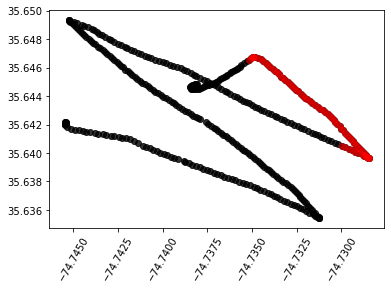

In [14]:
for md in mds:
    plt.scatter(md['Longitude'],md['Latitude'], color='black', alpha=0.8)
for md in mds[-115:-45]:
    plt.scatter(md['Longitude'],md['Latitude'], color='red', alpha=0.5)
plt.xticks(rotation=60)
plt.show()

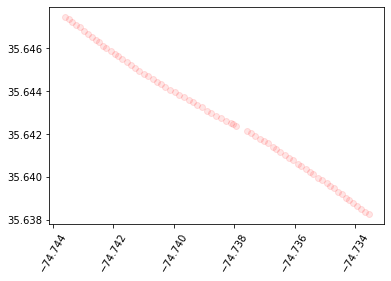

In [15]:
for md in mds[138:-215]:
    plt.scatter(md['Longitude'],md['Latitude'], color='red', alpha=0.1)
plt.xticks(rotation=60)
plt.show()

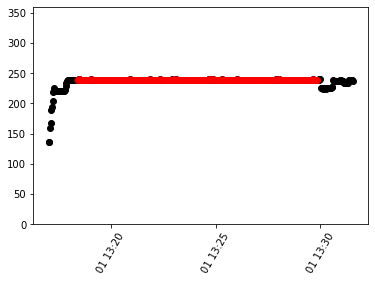

In [17]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'], color='black')

for md in mds[40:-50]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'], color='red', alpha=0.5)
plt.ylim(0,360)
plt.xticks(rotation=60)
plt.show()

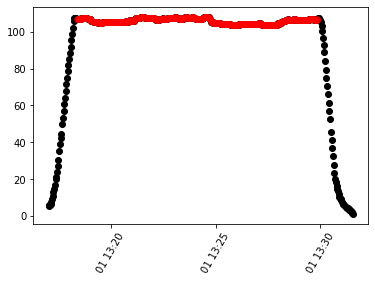

In [18]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_altitude'], color='black')

for md in mds[40:-50]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_altitude'], color='red', alpha=0.5)
plt.xticks(rotation=60)
plt.show()

#### Open up a subset of the images to visualize based on the above metadata

All images can't be opened at the same time given the load on computer memory

In [19]:
start = 40 # 138 # where to start in the image order
count = 40 # how many images to open
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [20]:
sea_imgs.shape

(40, 6, 1470, 2023)

Find the closest row in the flight logs based on time stamp and add the more accurate yaw to the metadata

In [21]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-08-28-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]
    item['alta_altitude'] = float(alta_logs.iloc[img_idx]['GPS Height'])

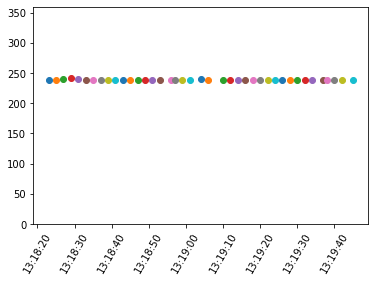

In [22]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'])
    plt.xticks(rotation=60)
    plt.ylim(0,360)

In [23]:
sea_imgs.nbytes / 1e9

5.7097152

Open up the data from the sunblocked approach measurements

In [24]:
blocked_dir = os.path.join('data/210828_A1_frontcross1', 'RedEdge', 'tube', 'stacks')
blocked_dir

'data/210828_A1_frontcross1/RedEdge/tube/stacks'

In [27]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=20, start=0, altitude_cutoff=0)

In [28]:
len(blocked_imgs)

16

Inspect a couple images, first with just blue and green

In [29]:
band_names = ['blue', 'green', 'red', 'nir', 'red edge']

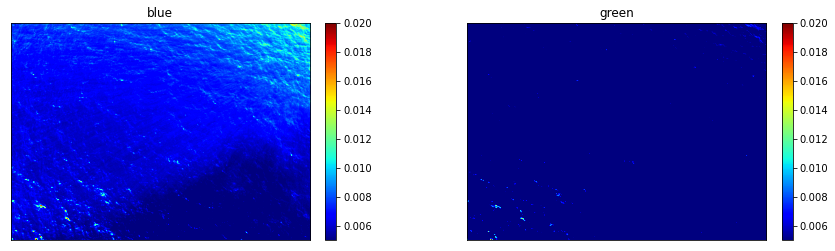

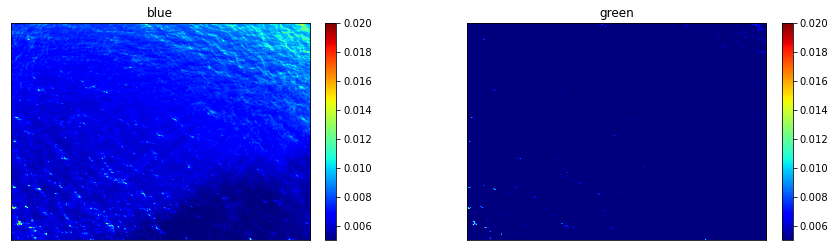

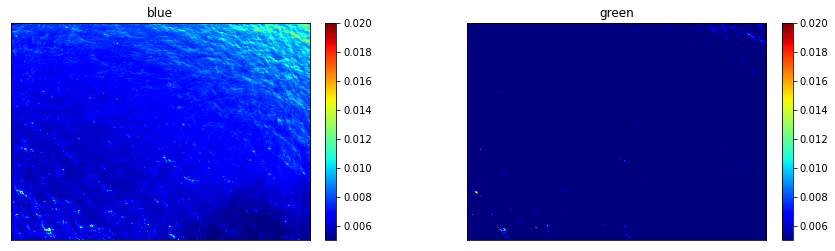

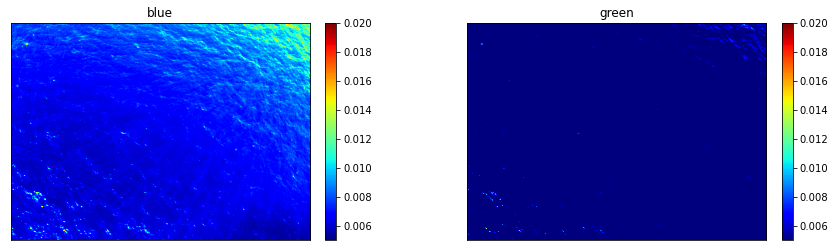

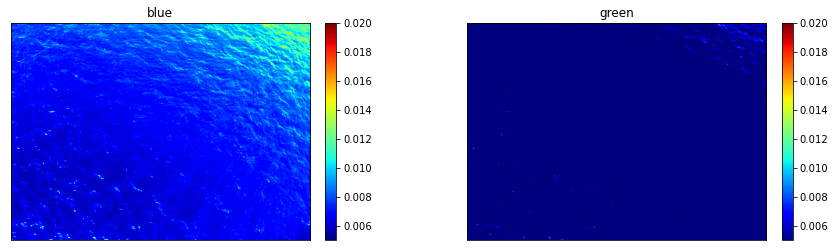

...

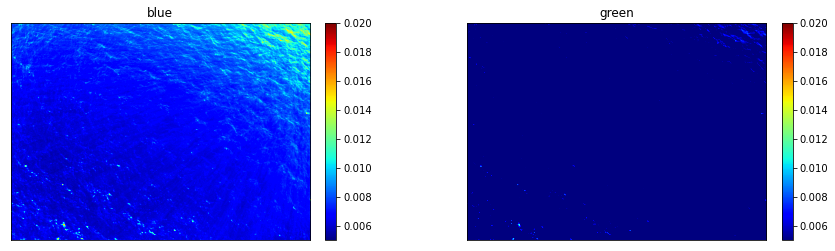

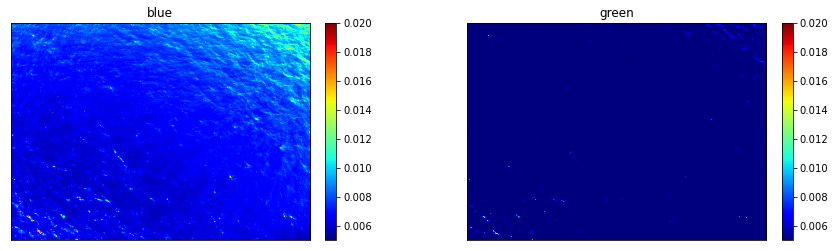

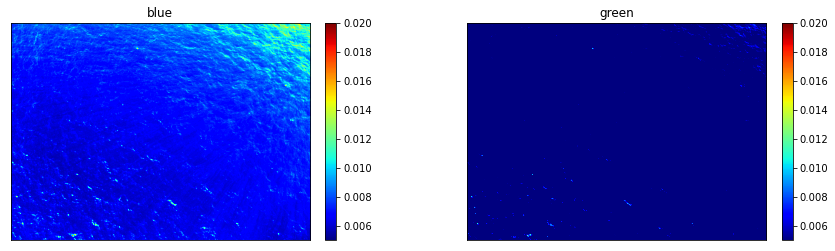

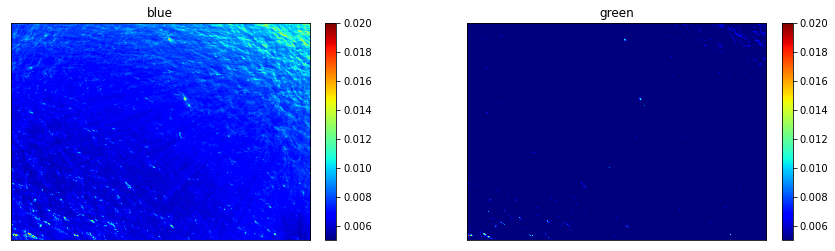

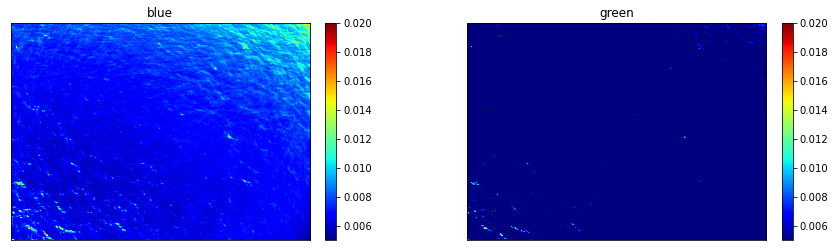

In [30]:
for i in range(15):
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

Now look at all bands

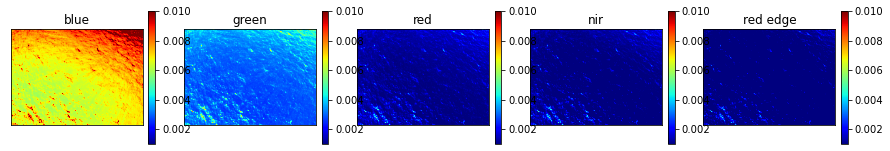

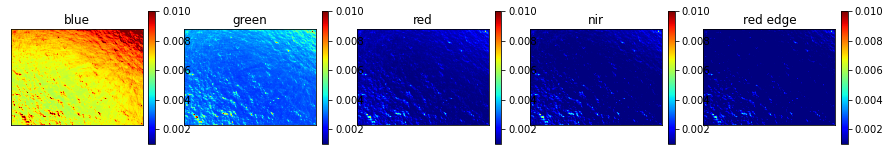

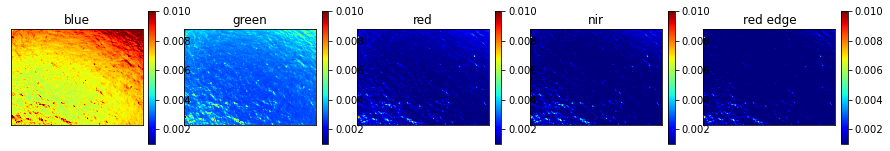

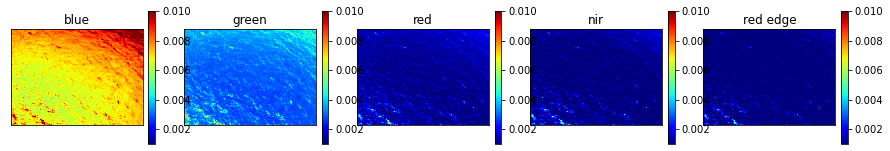

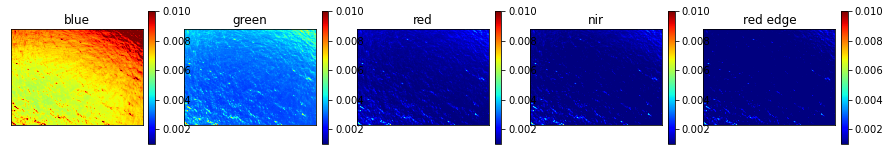

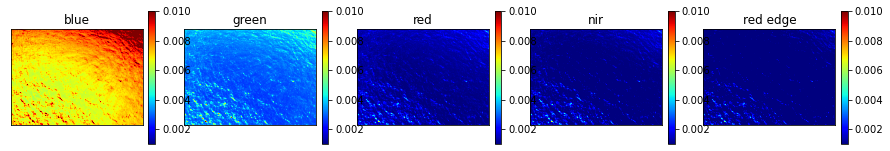

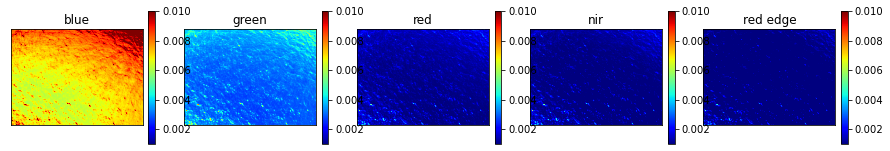

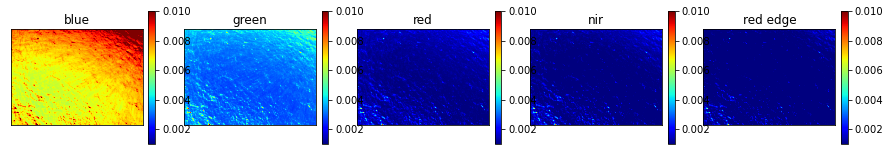

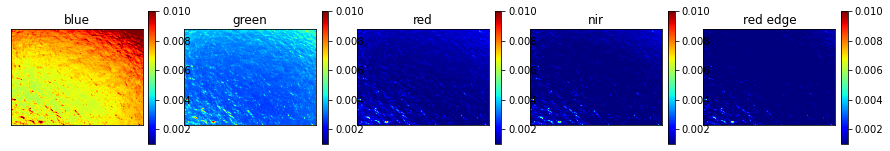

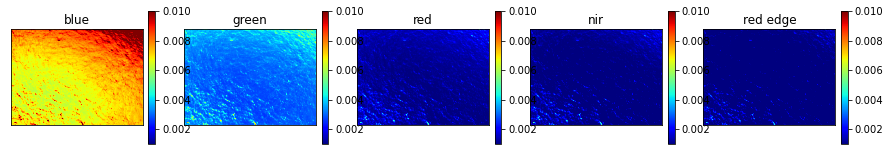

In [31]:
for j in range(20,30):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.001, vmax=.01)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

Visualize some stacked RGB images, the 0.01 value is just empirical to get a good idea of how the image looks when properly stretched

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


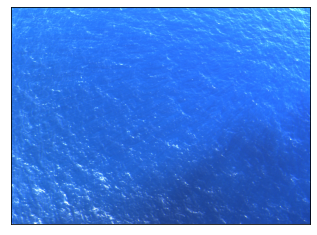

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


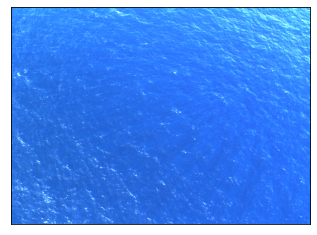

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


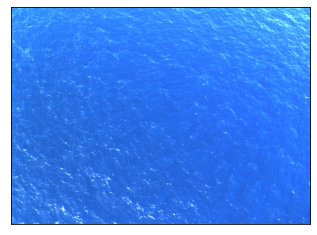

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


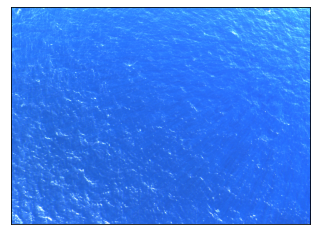

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


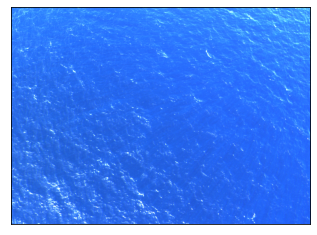

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


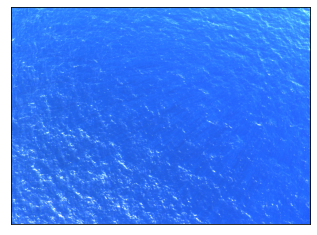

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


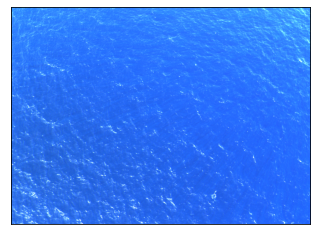

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


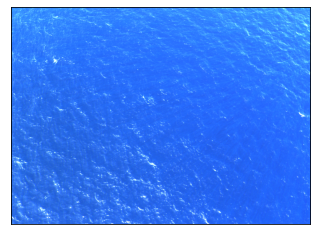

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


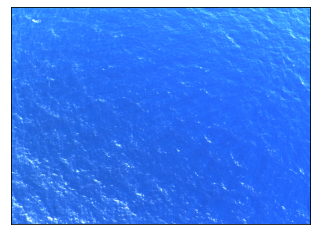

In [33]:
for j in [0,5,10,15,20, 25,30,35, 39,]:
    plt.imshow((np.transpose(sea_imgs[j,0:3]/0.007, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

Save out every file as a png just for visualization

In [ ]:
for i in range(50,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    fig,ax = plt.subplots(1,2,figsize=(16,6))
    ax[0].imshow((np.transpose(img[0,0:3]/0.01, (1,2,0))[:,:,::-1]))
    ax[1].imshow(img[0,5]*math.pi*32768/100-273.15,cmap='inferno', vmax=30,vmin=25)
    fig.savefig('data/210827_A2_frontcross2/anims/img_sst_'+str(i).zfill(4)+'.png')   # save the figure to file
    plt.close()  

## Start correction to obtain accurate Ls*rho from Lw from Lt measurements 

### create medians of each image for correction

In [50]:
sea_imgs.shape

(40, 6, 1470, 2023)

Which images are used to median the data has a major impact on the outcome and must be images without major outlier features or patterns

In [34]:
sea_median = np.median(sea_imgs[10:40], axis=0)

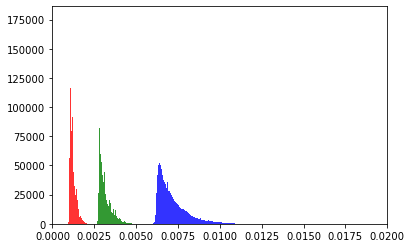

In [35]:
plt.hist(sea_median[0].flatten(), bins=300, color='blue', alpha=0.8)
plt.hist(sea_median[1].flatten(), bins=300, color='green', alpha=0.8)
plt.hist(sea_median[2].flatten(), bins=300, color='red', alpha=0.8)
plt.xlim(0.000,0.02)
plt.show()

In [36]:
np.median(sea_median, axis=(1,2))

array([0.00689697, 0.00303078, 0.00115111, 0.00096169, 0.00076255,
       0.28998373])

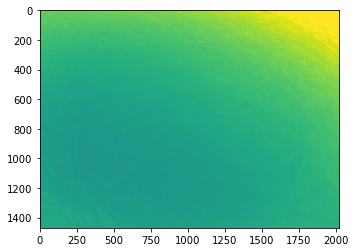

In [37]:
plt.imshow(sea_median[0], vmin=0.002,vmax=.01, cmap='viridis')

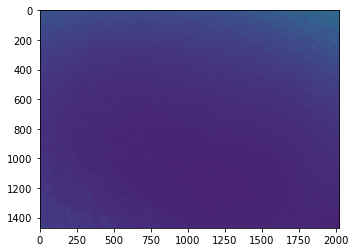

In [38]:
plt.imshow(sea_median[1], vmin=0.002,vmax=.01, cmap='viridis')

#### inspect the sun blocked spectra based on the brightest pixels there

The assumption is that the brightest pixels will be the ones that are measureing Lw rather than the tube since the imagers FOV is so large

In [39]:
blocked_imgs.shape

(16, 5, 947, 1271)

brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203
brightest pixels used: 1203


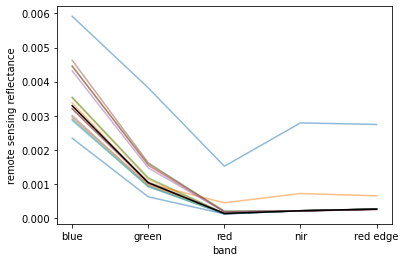

In [40]:
blocked_spectra = []
for i in range(0,blocked_imgs.shape[0]):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.001)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)
plt.plot(band_names, np.median(blocked_spectra,axis=0), color='black')

We then take the median of these brightest spectra to get the value used. This relies on a dozen or so measurements to ensure that outliers like from foam don't bias the measurements.

In [41]:
median_blocked_spec = np.median(blocked_spectra,axis=0)
median_blocked_spec

array([0.00329147, 0.00103587, 0.00013409, 0.00021306, 0.00026133])

This is the L8 OC2 algorithm from NASA

In [42]:
vec_chla_img(median_blocked_spec[0],median_blocked_spec[1])

1.159752371339837

Hu et al OCI algorithm

In [43]:
print('chla is: ', oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]))

chla is:  0.21189472119664554


In [61]:
def combined_oc(ChlCI, oc2m):
    thresh = [0.15, 0.20]
    if ChlCI <= thresh[0]:
        chlor_a = ChlCI
    elif ChlCI > thresh[1]:
        chlor_a = oc2m
    else:
        chlor_a = oc2m * (ChlCI-thresh[0]) / (thresh[1]-thresh[0]) +\
            ChlCI * (thresh[1]-ChlCI) / (thresh[1]-thresh[0])
    return(chlor_a)


In [62]:
combined_oc(oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]),
            vec_chla_img(median_blocked_spec[0],median_blocked_spec[1]))

0.614439075798122

Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

### Correct for sun glint

This is the current approach to calculating rho based on sunblocked spectra

Simple explaination is:

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images.

Sea median - blocked_spectra is equivalent to lsky * rho. So then to get Lw in the future from Lt measurements all you need to do is subtract lsky * rho from Lt.

Calculate the smoothed Lt - Lw

This needs to be heavily smoothed so that no random waves remain in the final rho*Lsky

In [46]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0)).T), sigma=(0, 45,45), order=0)

Visualize the sea median bands that we calculated previously

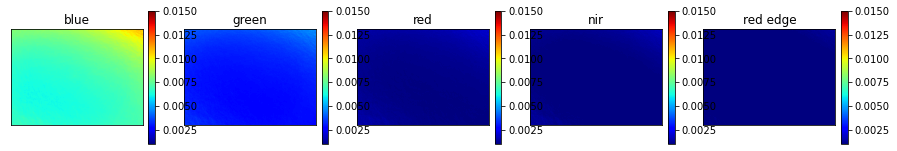

In [44]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

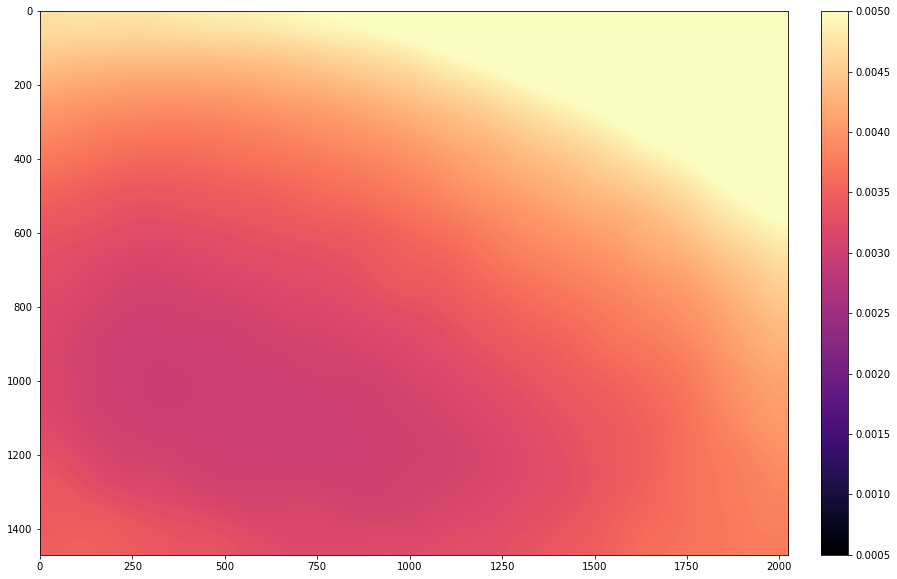

In [48]:
fig, ax = plt.subplots(figsize=(15,10))
im = ax.imshow(smoothed_lt_lw[0],cmap='magma', vmin=0.0005, vmax=.005)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Sea median images divided by image mean

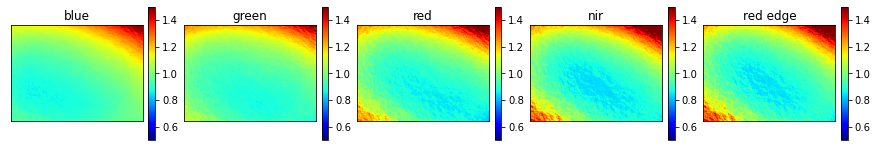

In [49]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Histogram of data from these bands

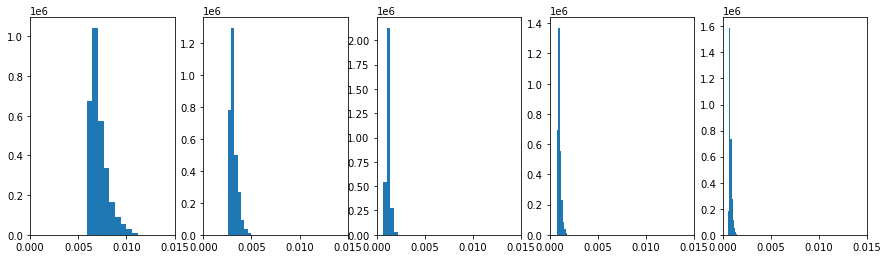

In [50]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    ax[i].hist(sea_median[i].flatten())
    ax[i].set_xlim(0,.015)

Smoothed lt - lw images (aka rho*lsky)

**This is what will be subtracted from each image**

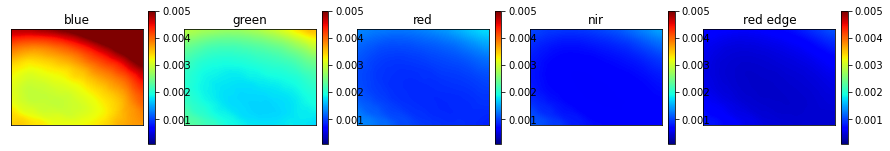

In [51]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.0001, vmax=.005)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

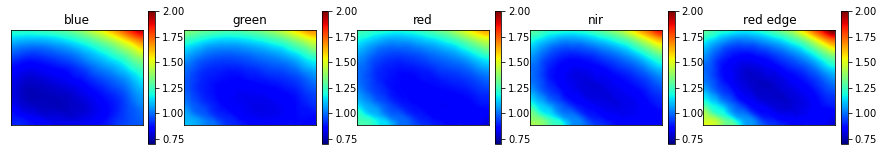

In [52]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

First look at all bands

In [53]:
sea_imgs.shape

(40, 6, 1470, 2023)

In [54]:
np.median(blocked_spectra, axis=0)

array([0.00329147, 0.00103587, 0.00013409, 0.00021306, 0.00026133])

In [55]:
np.median(sea_imgs[0], axis=(1,2))

array([0.00638213, 0.00305021, 0.00116569, 0.0009714 , 0.00079655,
       0.29127569])

In [56]:
np.median(smoothed_lt_lw, axis=(1,2))

array([0.00360762, 0.00199705, 0.00102059, 0.00074941, 0.00050113])

[0.00276931 0.00097609 0.0001182  0.00020068 0.00027685]


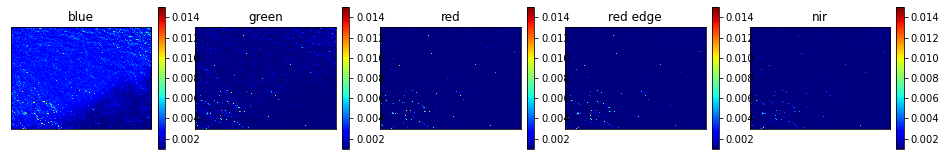

[0.0028596  0.00101443 0.0001357  0.00021472 0.00028547]


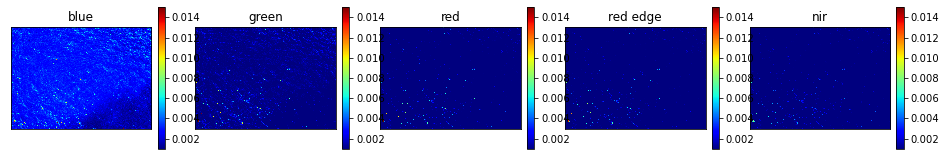

[0.00293844 0.00106703 0.00015099 0.00023651 0.0002915 ]


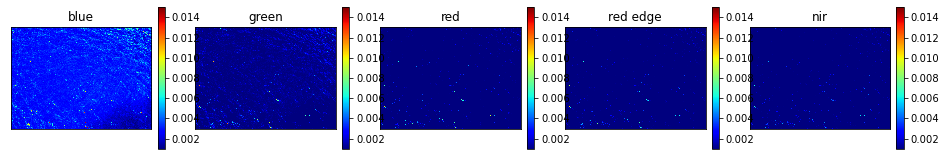

[0.00306413 0.00112315 0.00016708 0.00023296 0.0002979 ]


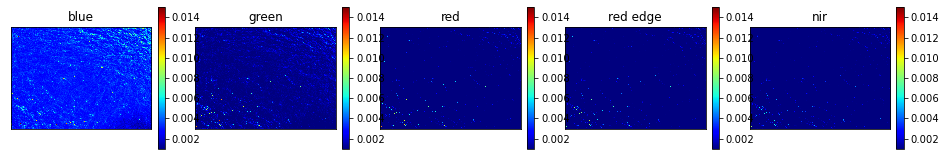

[0.00317455 0.0011814  0.000197   0.00027871 0.00029363]


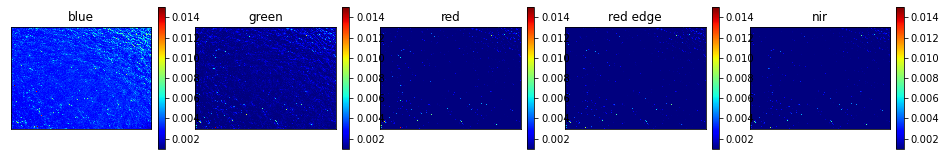

[0.00316324 0.00117164 0.0001911  0.00026823 0.00029251]


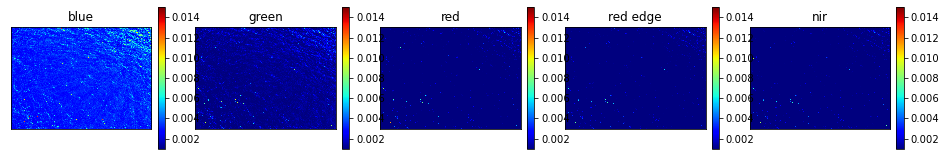

[0.00321165 0.00118692 0.00020869 0.00026715 0.00030446]


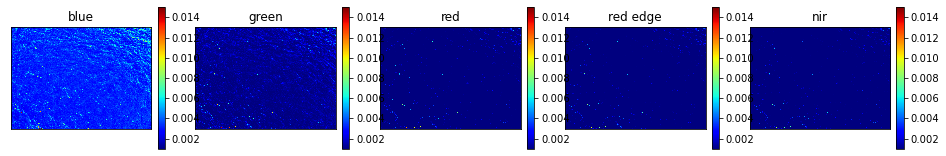

[0.00316912 0.00116586 0.00019754 0.00026229 0.00029507]


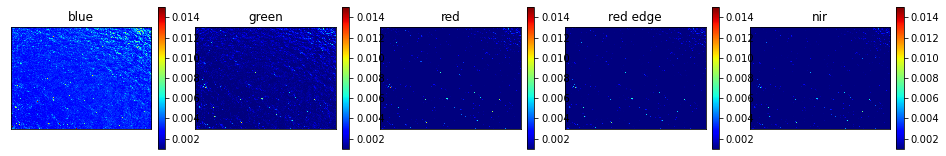

[0.0031621  0.00115948 0.00019677 0.00028042 0.00029335]


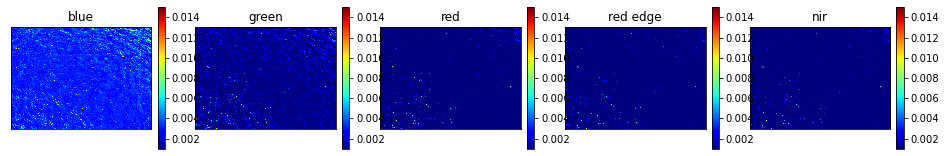

[0.00315973 0.00115767 0.0001907  0.00026719 0.00029423]


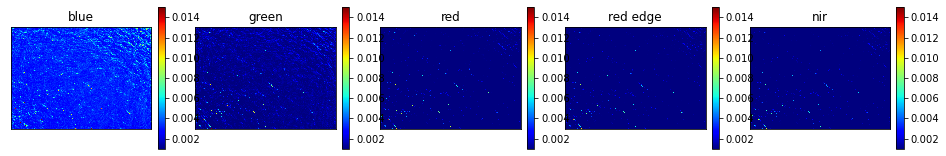

[0.00309691 0.00114498 0.00017129 0.00025454 0.0002782 ]


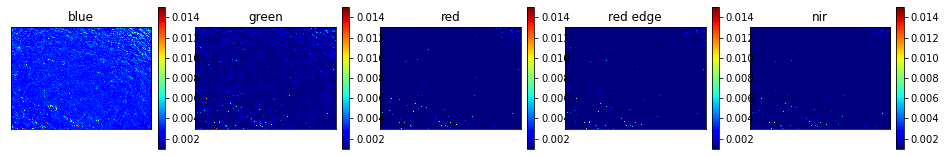

[0.00311199 0.00116186 0.00017677 0.00025379 0.00028123]


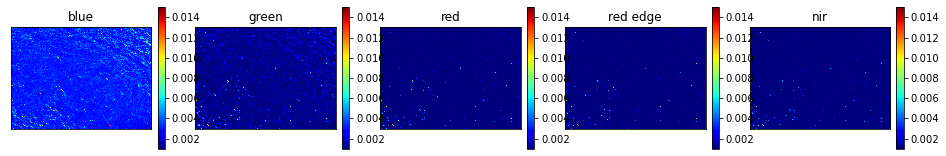

[0.00313872 0.00111024 0.00017716 0.00026185 0.00028258]


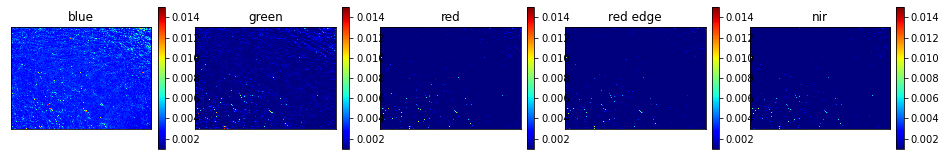

[0.00315212 0.00112151 0.00017309 0.00023147 0.00028291]


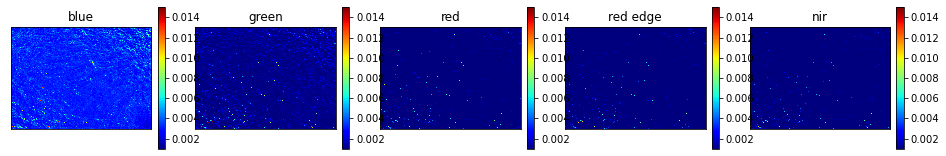

[0.00311631 0.0010824  0.00015759 0.0002367  0.00027089]


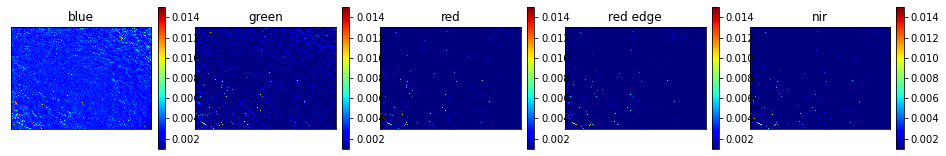

[0.00315326 0.00108045 0.00015666 0.00023287 0.00027425]


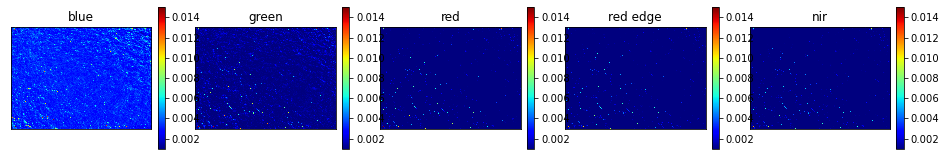

[0.00312629 0.00106275 0.00015454 0.00021718 0.00027531]


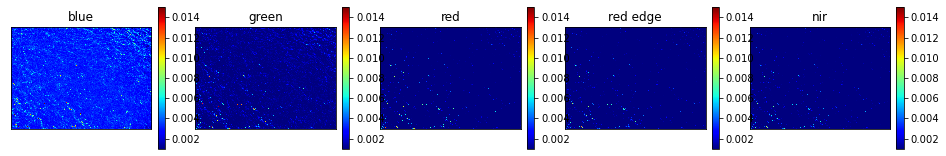

[0.00313851 0.00102499 0.00014882 0.00021971 0.00027373]


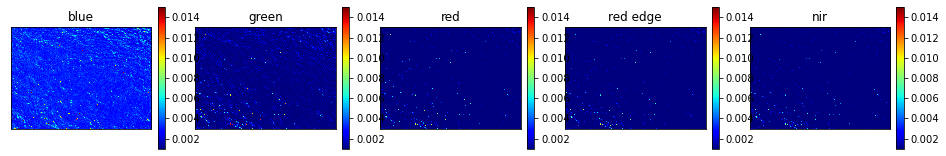

[0.00318263 0.00101031 0.00014723 0.00021418 0.00026913]


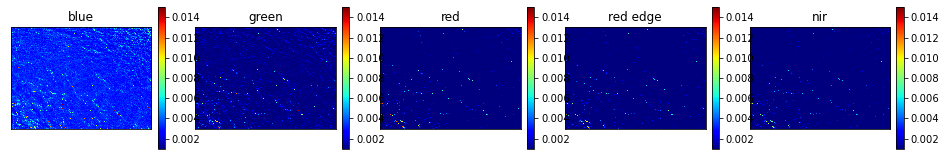

[0.00320423 0.00099617 0.00013058 0.00019278 0.00026531]


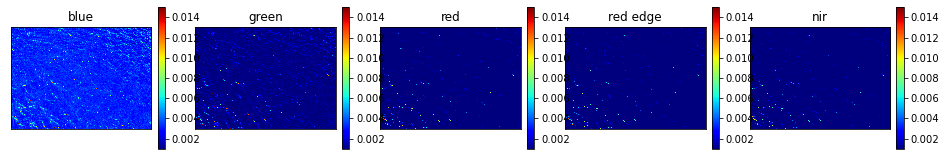

In [57]:
for i in range(0,20):
    print(np.median(sea_imgs[i,:5] - smoothed_lt_lw, axis=(1,2)))
    visualize_darkest_pixels(sea_imgs[i,:5] - smoothed_lt_lw, lowest_percent=1, max_clim=0.015, min_clim=0.001, only_img=True)

Now let's look at before and after with blue and green bands using the same scale and filtering out some of the brightest pixels.

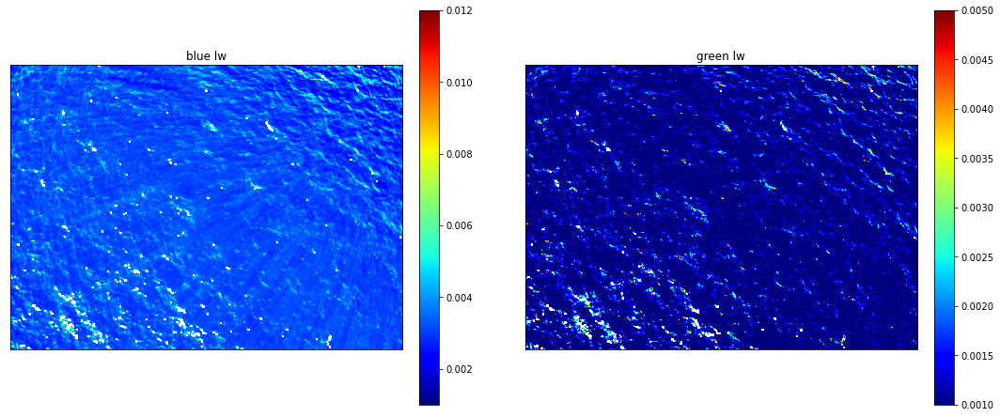

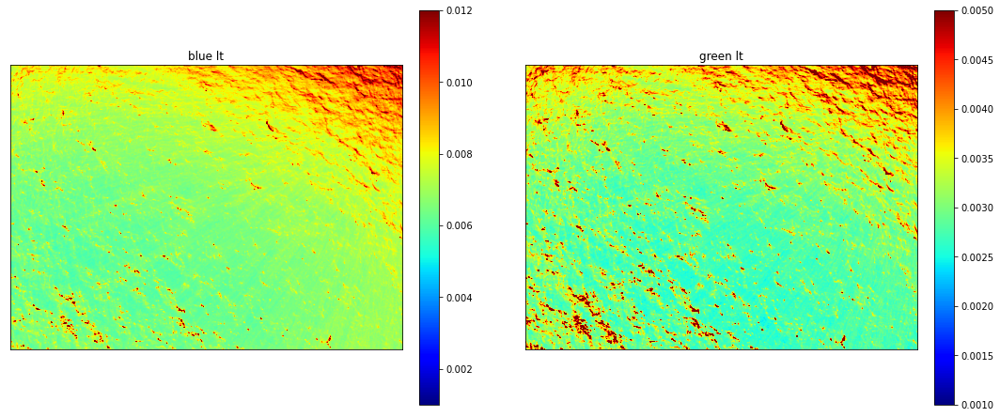

In [58]:
for i in range(20,35):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.012] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.001, vmax=.012)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    #ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    ax[0].set_title('blue lw')
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.001, vmax=.005)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
#     plt.savefig('oc_analysis_20210827_A2_gulf_stream_surveys_lw_img.png')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.001, vmax=.012)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lt')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.001, vmax=.005)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lt')
#     plt.savefig('oc_analysis_20210827_A2_gulf_stream_surveys_lt_img.png')
    plt.show()
    break

In general this seems to remove the sky reflection and the glare pixels 

#### Inspect the spectra from this

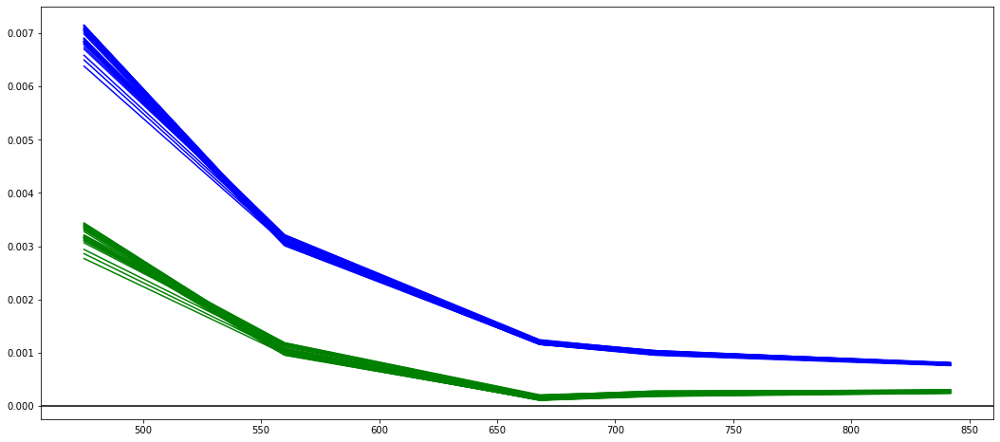

In [59]:
fig, ax = plt.subplots(figsize=(18,8))

for i in range(0,40):
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
#    img[img > 0.055] = np.nan
    
    ax.plot([475, 560, 668, 717, 842],np.nanmedian(img,axis=(1,2)), color='green')
    ax.plot([475, 560, 668, 717, 842],np.nanmedian(sea_imgs[i,:5],axis=(1,2)), color='blue')
ax.axhline(0, color='black')

### Running analysis on all data

See the shift to more normal distributions after the corrections.

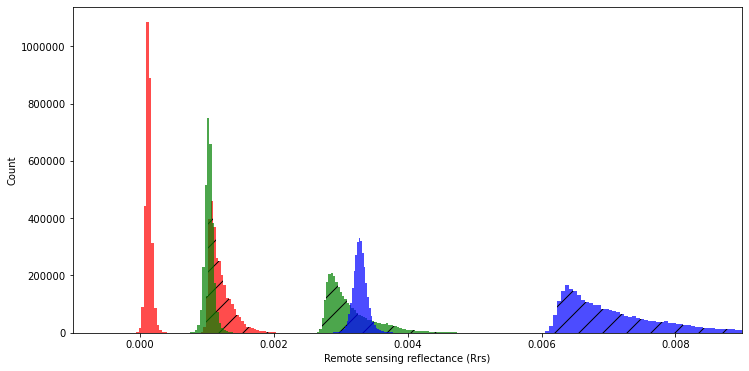

In [60]:
fig, ax = plt.subplots(figsize=(12,6))
ax.hist(sea_median[0,:,:].flatten(), bins=100, color='blue', hatch='/',alpha=0.7,)
ax.hist(sea_median[1,:,:].flatten(), bins=100, color='green', hatch='/',alpha=0.7)
ax.hist(sea_median[2,:,:].flatten(), bins=100, color='red',hatch='/',alpha=0.7)

ax.hist((sea_median[0,:,:]-smoothed_lt_lw[0]).flatten(), bins=100, color='blue', alpha=0.7)
ax.hist((sea_median[1,:,:]-smoothed_lt_lw[1]).flatten(), bins=100, color='green', alpha=0.7)
ax.hist((sea_median[2,:,:]-smoothed_lt_lw[2]).flatten(), bins=100, color='red', alpha=0.7)

ax.ticklabel_format(style='plain')
ax.set_ylabel('Count')
ax.set_xlabel('Remote sensing reflectance (Rrs)')

plt.xlim(-0.001,.009)
# plt.savefig('oc_analysis_20210826_A1_gulf_stream_surveys_hist_lw_lt_sea_median.png')
plt.show()

In [61]:
sea_median.shape

(6, 1470, 2023)

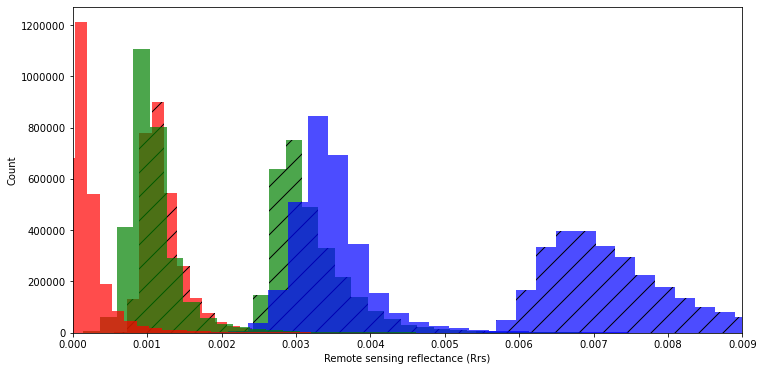

In [62]:
fig, ax = plt.subplots(figsize=(12,6))
ax.hist(sea_imgs[30,0,:,:].flatten(), bins=100, color='blue', hatch='/',alpha=0.7,)
ax.hist(sea_imgs[30,1,:,:].flatten(), bins=100, color='green', hatch='/',alpha=0.7)
ax.hist(sea_imgs[30,2,:,:].flatten(), bins=100, color='red',hatch='/',alpha=0.7)

ax.hist((sea_imgs[30,0,:,:]-smoothed_lt_lw[0]).flatten(), bins=100, color='blue', alpha=0.7)
ax.hist((sea_imgs[30,1,:,:]-smoothed_lt_lw[1]).flatten(), bins=100, color='green', alpha=0.7)
ax.hist((sea_imgs[30,2,:,:]-smoothed_lt_lw[2]).flatten(), bins=100, color='red', alpha=0.7)

ax.ticklabel_format(style='plain')
ax.set_ylabel('Count')
ax.set_xlabel('Remote sensing reflectance (Rrs)')

plt.xlim(0,0.009)
plt.show()

#### Visualize chla output from current approach 

In [63]:
sea_imgs.shape

(40, 6, 1470, 2023)

ocx median is:
0.2386853282145429


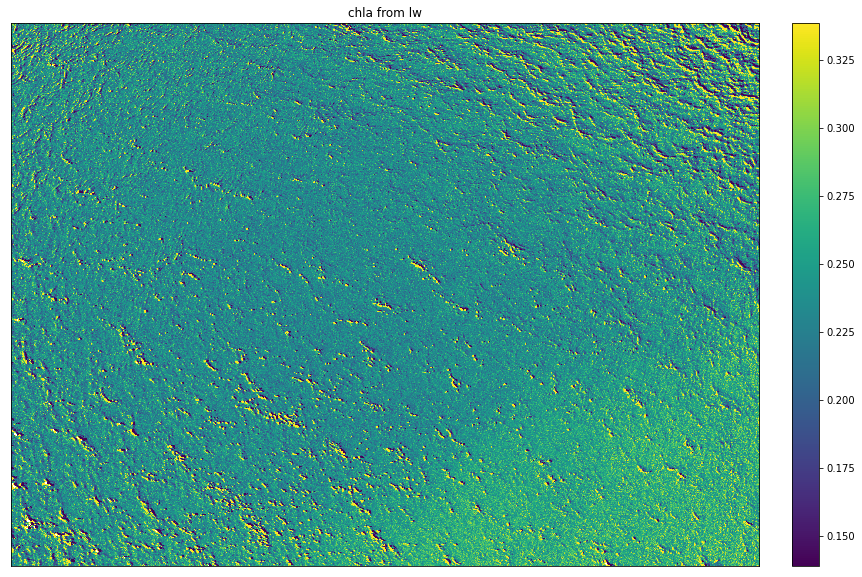

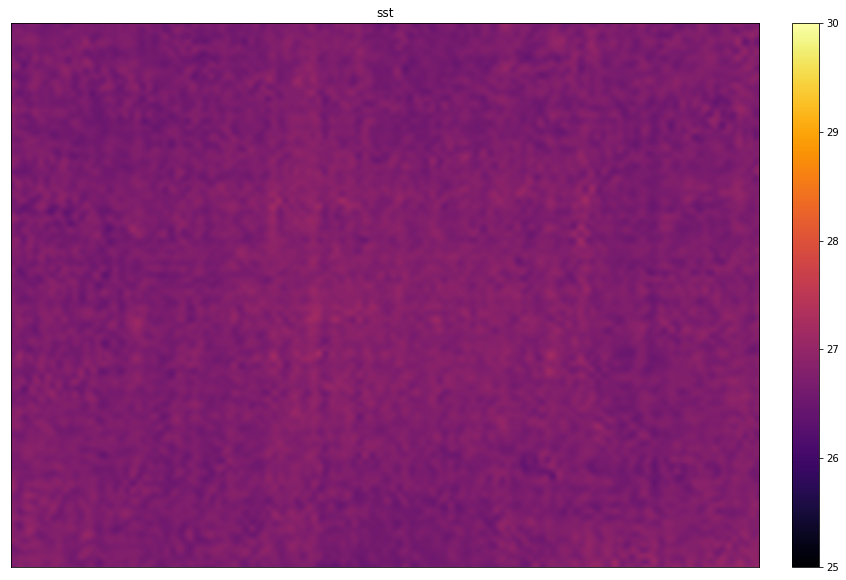

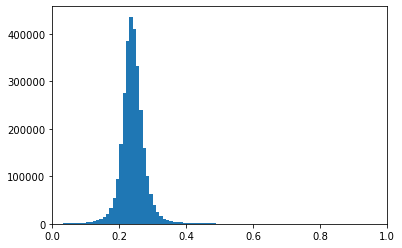

ocx median is:
0.23665654820205378


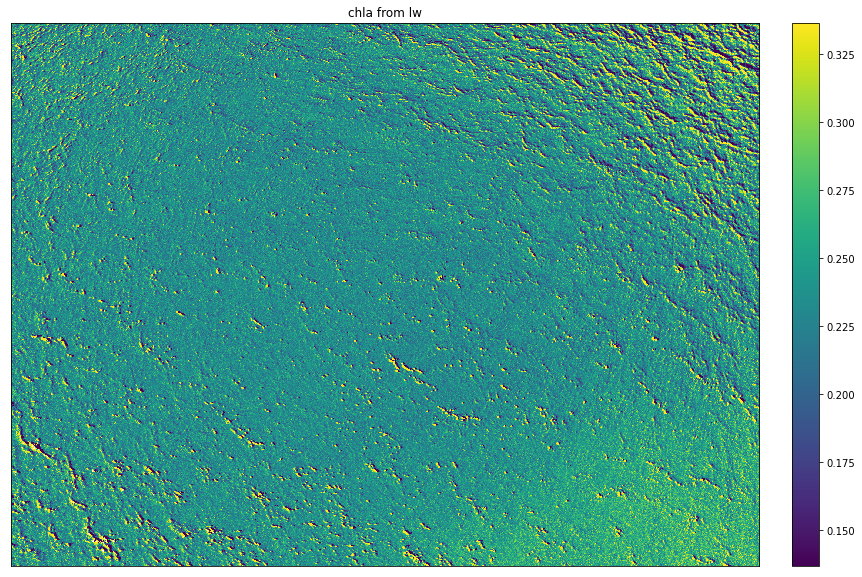

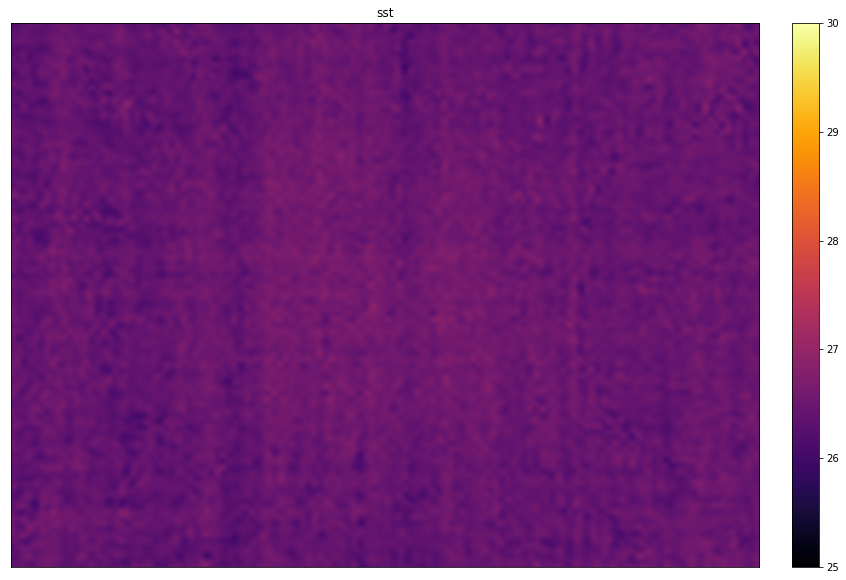

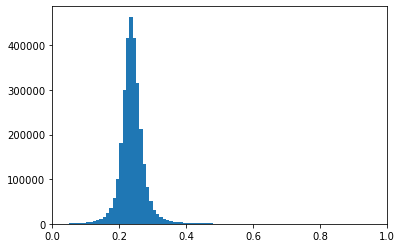

ocx median is:
0.23319015873428153


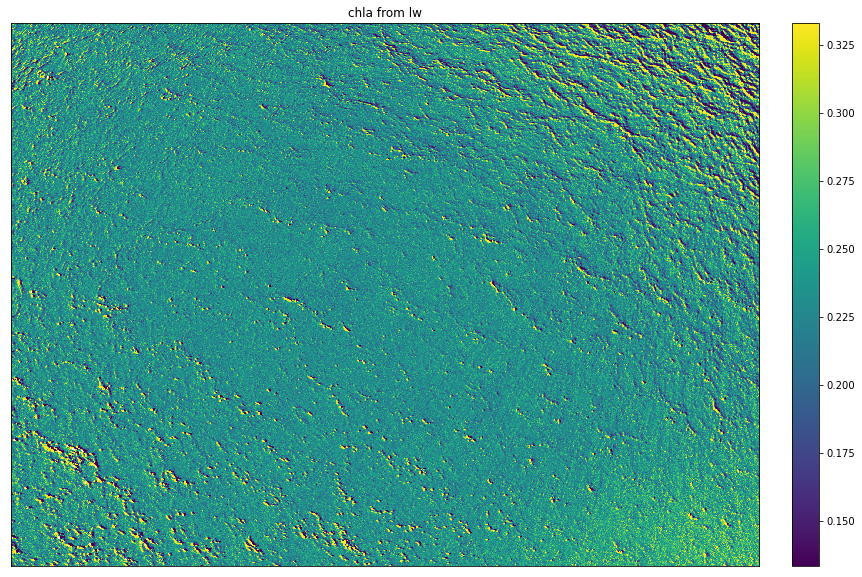

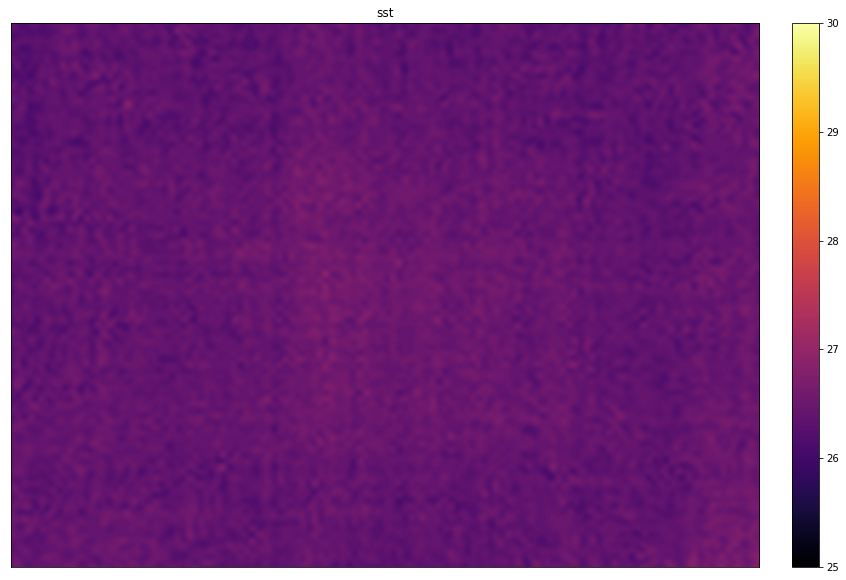

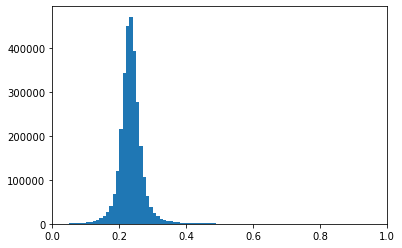

ocx median is:
0.23070253819448777


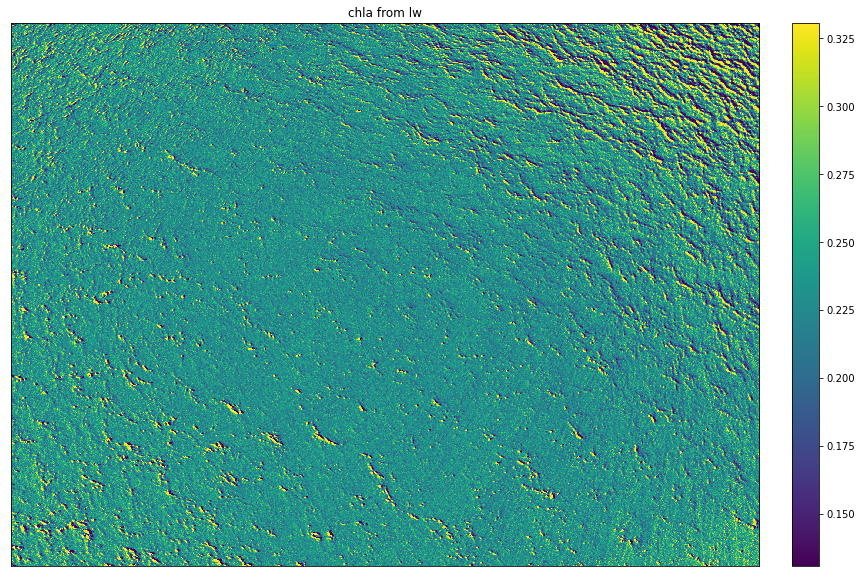

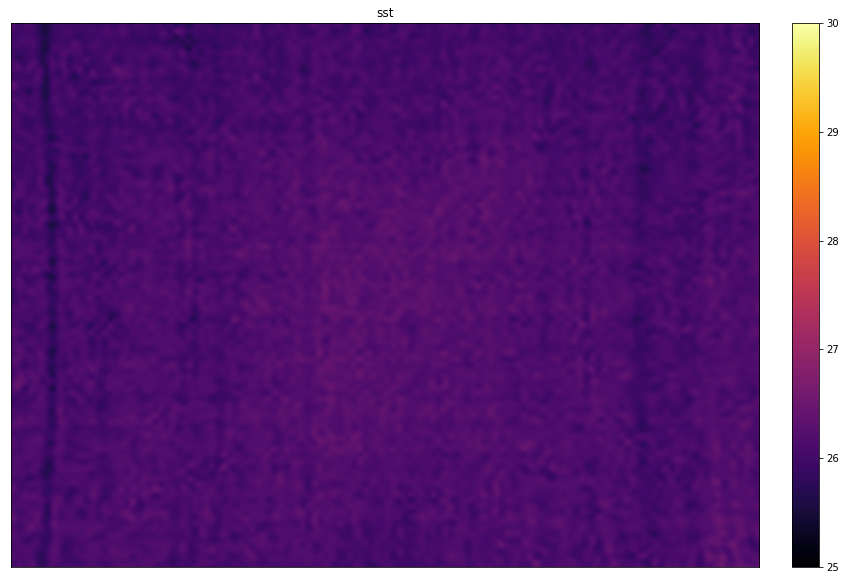

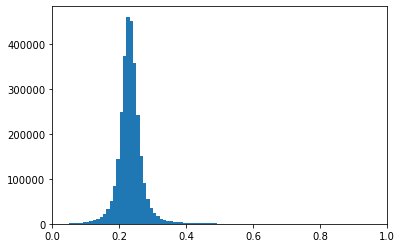

ocx median is:
0.23045231210752976


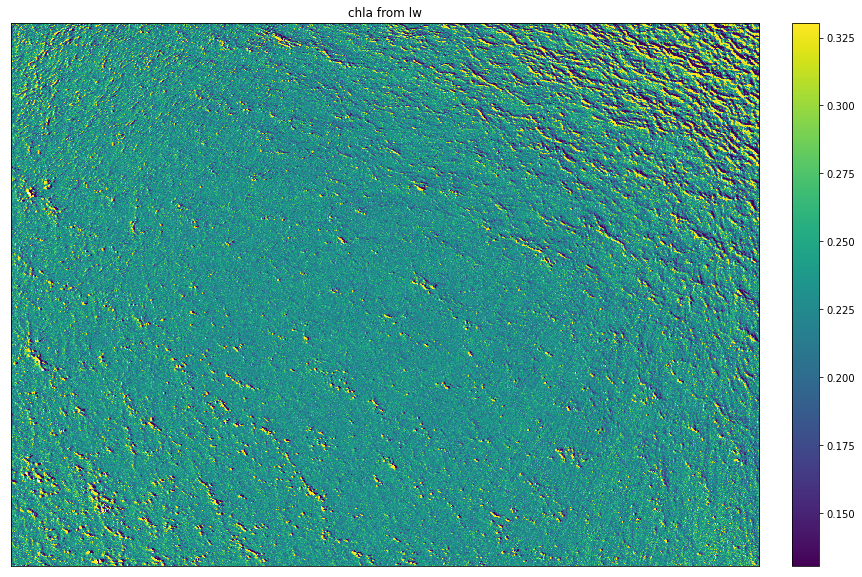

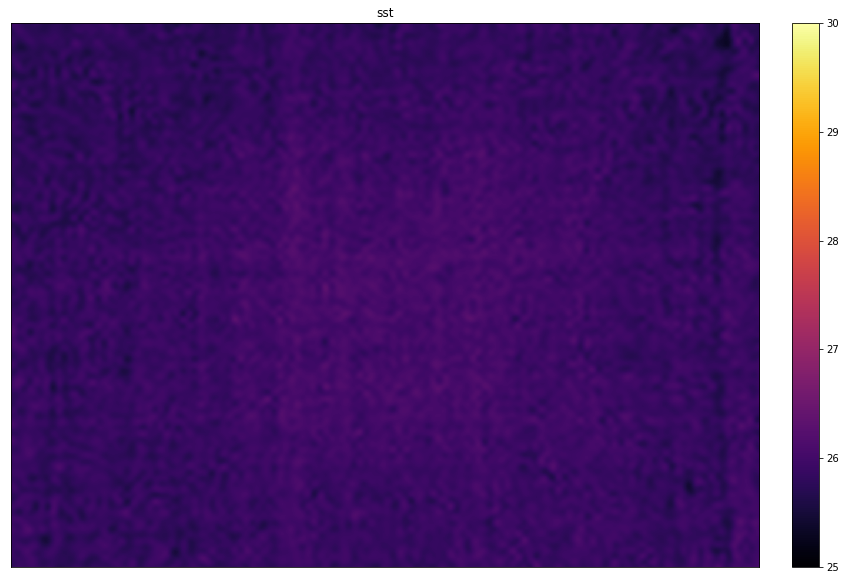

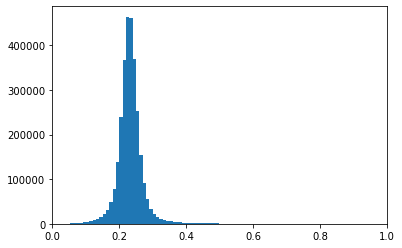

ocx median is:
0.22856923840523863


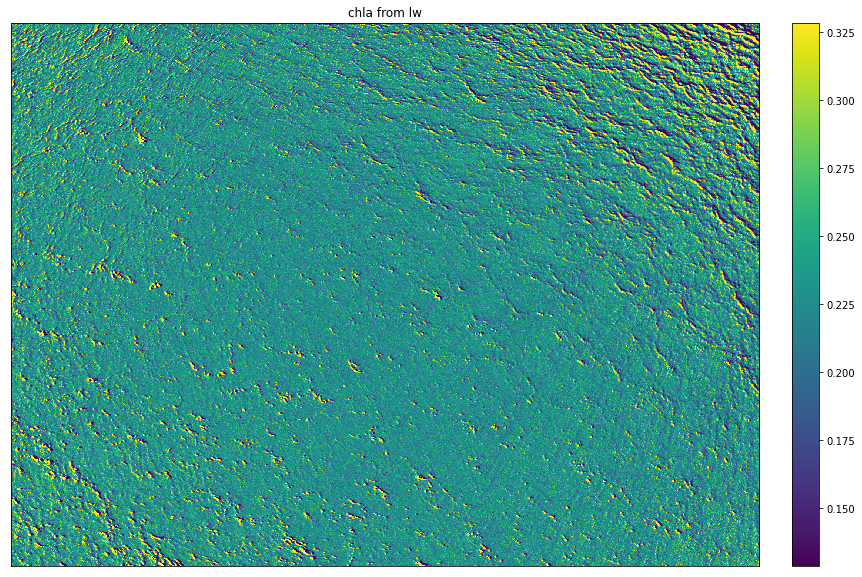

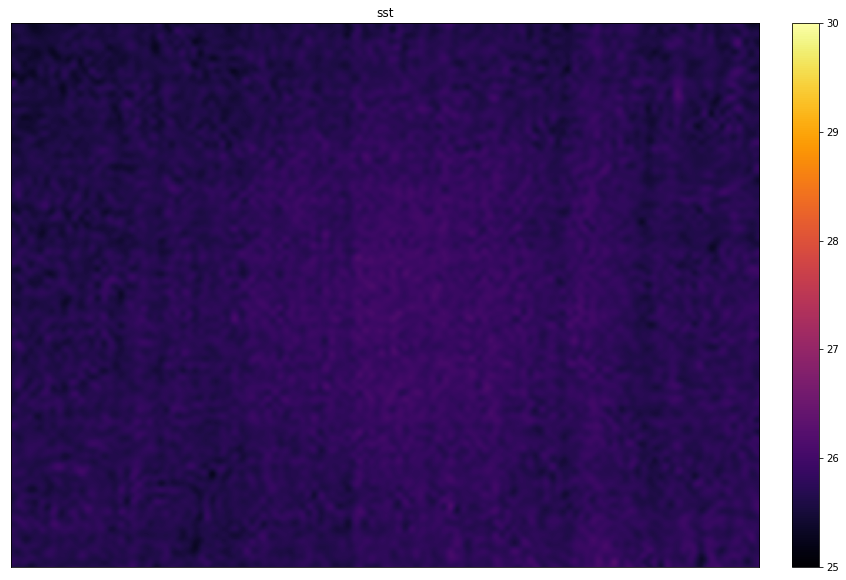

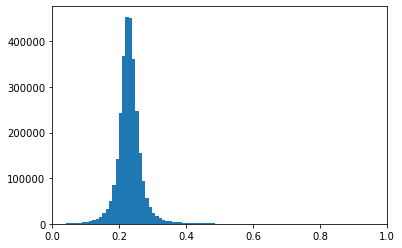

ocx median is:
0.229258612780228


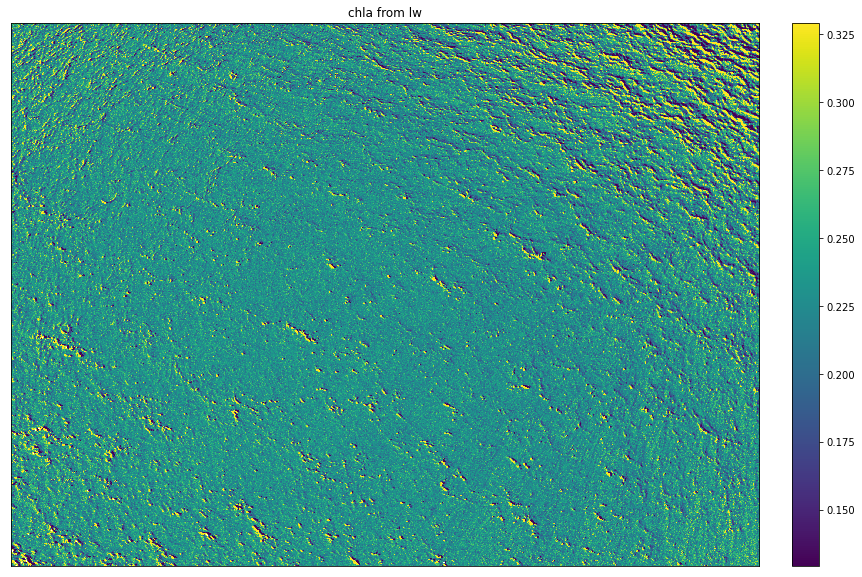

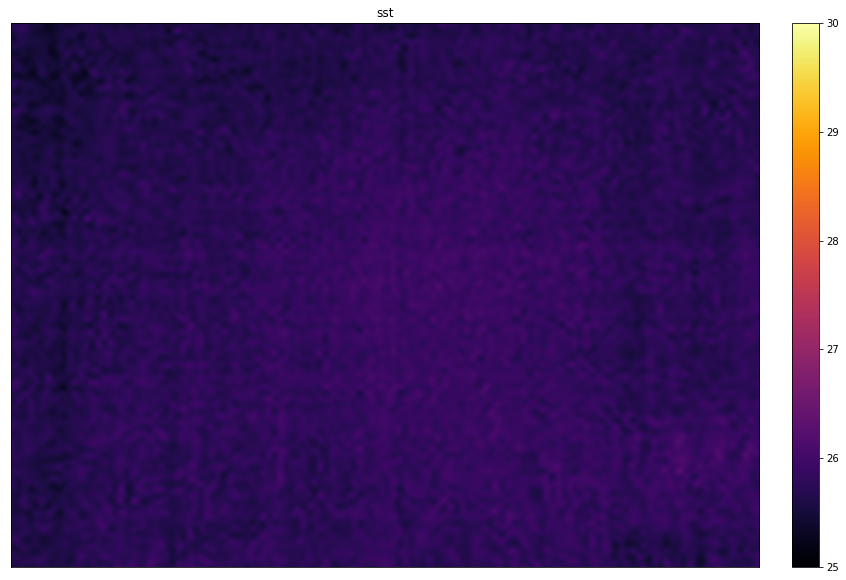

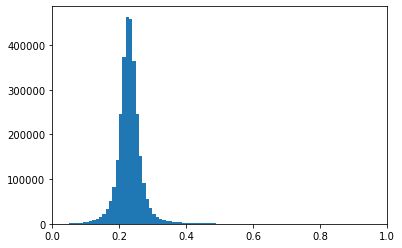

KeyboardInterrupt: 

In [64]:
for i in range(1,10):
    
    img = sea_imgs[i,:5].copy() - smoothed_lt_lw
    #img[np.repeat((img[2] > 0.2)[np.newaxis,:,:],5,axis=0)] = np.nan
    img[np.repeat((img[0] < 0)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    chla_oci = oc_index(img[0], img[1], img[2])
#     chla_oci = oc1_custom(img[0], img[1])
    chla_oci[chla_oci<0] = 0
    chla_oci[chla_oci>5] = np.nan
    
    img_median = np.nanmedian(img, axis=(1,2))
    print('ocx median is:')
    print(np.nanmedian(chla_oci))
    
    #print(vec_chla_img(img_median[0], img_median[1]))
    #print(np.nanmedian(chla_lw))
    fig, ax = plt.subplots(1, figsize=(15,10))
    im = ax.imshow(chla_oci,cmap='viridis', vmin=np.nanmedian(chla_oci)-.1, vmax=np.nanmedian(chla_oci)+.1, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()
    
    
    sst = sea_imgs[i,5]*math.pi*32768/100-273.15
    fig, ax = plt.subplots(1, figsize=(15,10))
    im = ax.imshow(sst,cmap='inferno', vmin=25, vmax=30, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('sst')
    plt.show()
    
#     plt.hist(img[0].flatten(),bins=500)
#     plt.xlim(-.05,.05)
#     plt.show()
    
#     plt.hist(img[1].flatten(),bins=500)
#     plt.xlim(-.05,.05)
#     plt.show()

    plt.hist(chla_oci.flatten(), bins=500)
    plt.xlim(0,1)
    plt.show()


What does this look like slightly blurred?

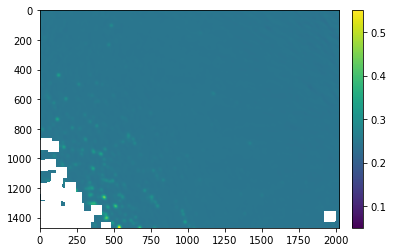

In [134]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_oci, sigma=(9, 9), order=0), cmap='viridis', vmin=0.05, vmax=0.55, interpolation='none')
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Fill gaps just to see whole image

In [135]:
# TODO this is not the *ideal* solution
# make a mask where there are nans
mask = np.isnan(chla_oci)
# get the indices where the mask is not existant
idx = np.where(~mask,np.arange(mask.shape[1]),0)
np.maximum.accumulate(idx,axis=1, out=idx)
out = chla_oci[np.arange(idx.shape[0])[:,None], idx]

In [136]:
from scipy import interpolate
#mask invalid values
x = np.arange(0, chla_oci.shape[1])
y = np.arange(0, chla_oci.shape[0])
array = np.ma.masked_invalid(chla_oci)
xx, yy = np.meshgrid(x, y)
#get only the valid values
x1 = xx[~array.mask]
y1 = yy[~array.mask]
newarr = array[~array.mask]

GD1 = interpolate.griddata((x1, y1), newarr.ravel(),
                          (xx, yy),
                             method='nearest')

In [137]:
GD1.shape

(1470, 2023)

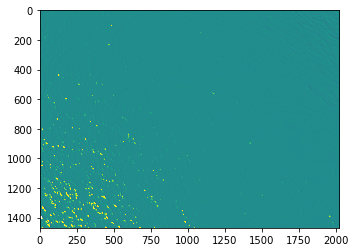

In [138]:
plt.imshow(out,cmap='viridis', vmin=0, vmax=.5)

Create a movie of all the data to watch change over time

In [90]:
for i in range(40,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    sst=img[0,5]*math.pi*32768/100-273.15
    
    fig,ax = plt.subplots(2,4,figsize=(21,8))
    
    # RGB, blue, green, chla
    ax[0,0].imshow((np.transpose(img[0,0:3]/0.01, (1,2,0))[:,:,::-1]))
    ax[0,0].set_title('RGB')
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    chla_img = oc_index(img[0], img[1], img[2])
#     chla_img = oc1_custom(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>5] = np.nan
    #chla_img[chla_img<1] = np.nan
    
    im = ax[0,1].imshow(img[0],cmap='jet', vmin=0.0, vmax=.01)
    fig.colorbar(im, ax=ax[0,1], fraction=0.034, pad=0.04)
    ax[0,1].set_xticks([])
    ax[0,1].set_yticks([])
    ax[0,1].set_title('blue lw')
    im = ax[0,2].imshow(img[1],cmap='jet', vmin=0.0, vmax=.01)
    fig.colorbar(im, ax=ax[0,2], fraction=0.034, pad=0.04)
    ax[0,2].set_xticks([])
    ax[0,2].set_yticks([])
    ax[0,2].set_title('green lw')
    

    
    im = ax[0,3].imshow(chla_img, vmin=0,vmax=.5, interpolation='none')
    fig.colorbar(im, ax=ax[0,3], fraction=0.034, pad=0.04)
    ax[0,3].set_title('chla')
    
    # SST, SST hist, all bands hist, chla hist
    
    
    im = ax[1,0].imshow(sst,cmap='inferno', vmax=25,vmin=31)
    fig.colorbar(im, ax=ax[1,0], fraction=0.034, pad=0.04)
    ax[1,0].set_title('SST')
    
    ax[1,1].hist(sst.flatten(), bins=80)
    ax[1,1].set_xlim(25,31)
    ax[1,1].set_title('SST histogram')
    
    
    
    ax[1,2].hist((img[4]).flatten(), bins=100, color='rosybrown', alpha=0.2)
    ax[1,2].hist((img[3]).flatten(), bins=100, color='grey', alpha=0.5)
    ax[1,2].hist((img[2]).flatten(), bins=100, color='red', alpha=0.5)
    ax[1,2].hist((img[1]).flatten(), bins=100, color='green', alpha=0.6)
    ax[1,2].hist((img[0]).flatten(), bins=100, color='blue', alpha=0.6)
    ax[1,2].set_xlim(0,0.015)
    ax[1,2].set_title('histogram of all bands')
    
    ax[1,3].hist(chla_img.flatten(), bins=100)
    ax[1,3].set_xlim(0,1)
    ax[1,3].set_title('chla histogram')
    fig.tight_layout()
    
#     plt.show()

    fig.savefig('data/210828_A1_frontcross1/anims/img_sst_hist_bkg'+str(i).zfill(4)+'.png', 
                facecolor='white', edgecolor='none', transparent=False)   # save the figure to file
    fig.clear()
    plt.close(fig)  
    
    del img
    del sst
    del chla_img

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

##### Inspect the data geographically

Turn each image to a point and put it into a gdf

In [66]:
lats = []
lons = []
chla_list = []
chla_dates = []
temps = []
spectras = []
for i in range(40,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    
    sst = img[0,5]
    sst_in_k = np.median(sst) *math.pi* 32768 / 100-273.15
#     plt.imshow(sst* 32768 / 100, vmin=288,vmax=292)
#     print(sst_in_k)
#     plt.show()
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    #img = sea_imgs[i,:5].copy() 
    #img[np.repeat((img[2] > 0.0075)[np.newaxis,:,:],5,axis=0)] = np.nan
    chla_img = oc_index(img[0], img[1], img[2])
#     chla_img = oc1_custom(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>5] = np.nan
    chla_med = np.nanmedian(chla_img)
    #img_median = np.nanmedian(img, axis=(1,2))
    #oc_med = oc_index(img_median[0], img_median[1], img_median[2])
    #oc_med = vec_chla_img(img_median[0], img_median[1])
    
    spectras.append(np.median(img,axis=[1,2]))

    chla_list.append(chla_med)
    lats.append(mds[i]['Latitude'])
    lons.append(mds[i]['Longitude'])
    chla_dates.append(datetime.datetime.strptime(mds[i]['Date']+' - '+mds[i]['UTC-Time'], '%m/%d/%Y - %H:%M:%S'))
    temps.append(sst_in_k)

In [67]:
len(chla_list)

336

<AxesSubplot:>

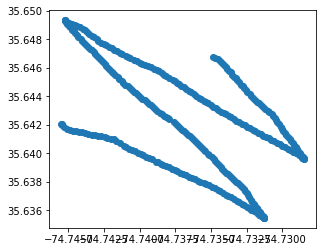

In [68]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates,
     'sst' : temps,
     'lw_spectra': spectras
    })

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

<AxesSubplot:>

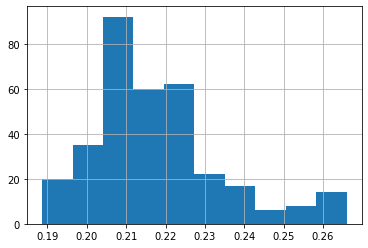

In [69]:
chla_gdf['chla'].hist()

<AxesSubplot:>

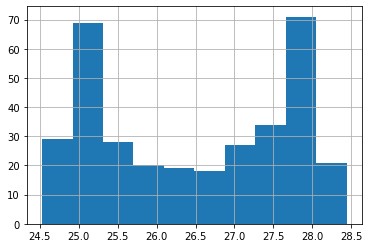

In [70]:
chla_gdf['sst'].hist()

In [71]:
# chla_gdf_short = chla_gdf.iloc[:150]

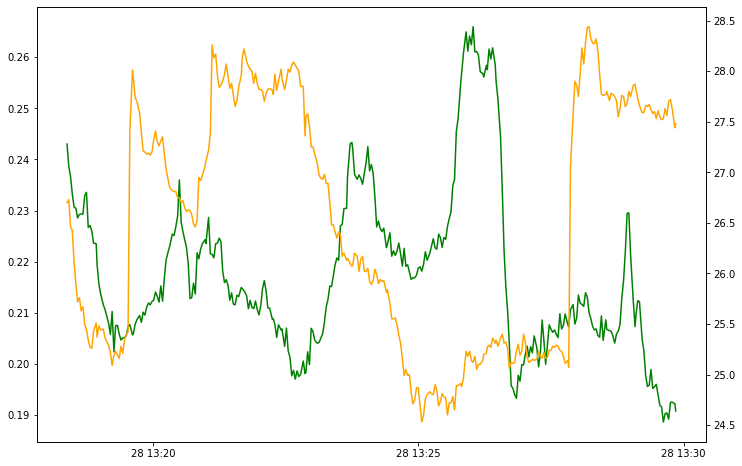

In [72]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.time, chla_gdf.chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.time, chla_gdf.sst, color='orange')

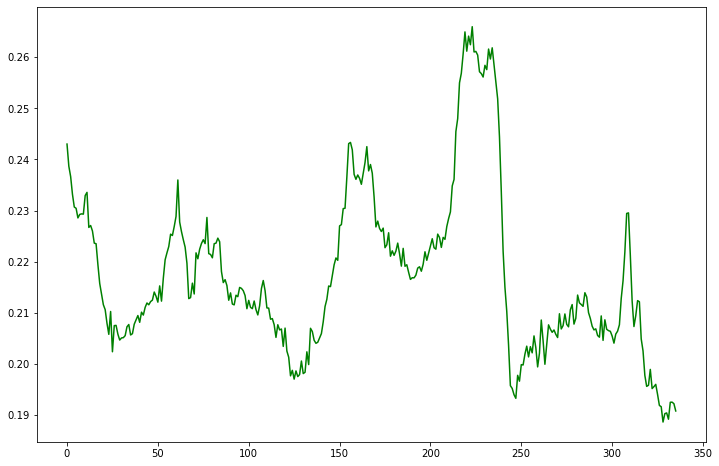

In [93]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(np.arange(0,336,1), chla_gdf.chla, color='green')

In [73]:
chla_gdf

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.243012,35.642033,-74.745492,2021-08-28 13:18:23,26.70,"[0.0027693066452314807, 0.0009760874485122972,...",POINT (-74.74549 35.64203)
1,0.238685,35.642022,-74.745483,2021-08-28 13:18:25,26.73,"[0.0028596017734027583, 0.0010144337457332346,...",POINT (-74.74548 35.64202)
2,0.236657,35.641953,-74.745442,2021-08-28 13:18:27,26.46,"[0.00293844035274714, 0.00106702800425646, 0.0...",POINT (-74.74544 35.64195)
3,0.233190,35.641831,-74.745331,2021-08-28 13:18:29,26.42,"[0.00306413065006593, 0.001123145862296873, 0....",POINT (-74.74533 35.64183)
4,0.230703,35.641714,-74.745125,2021-08-28 13:18:31,26.11,"[0.0031745535681886065, 0.001181395081591513, ...",POINT (-74.74513 35.64171)
...,...,...,...,...,...,...,...
331,0.189201,35.646328,-74.734225,2021-08-28 13:29:43,27.70,"[0.0037981322477814976, 0.00110213310735834, 0...",POINT (-74.73422 35.64633)
332,0.192514,35.646478,-74.734389,2021-08-28 13:29:45,27.72,"[0.0038258570379358604, 0.0011491281987806561,...",POINT (-74.73439 35.64648)
333,0.192537,35.646589,-74.734519,2021-08-28 13:29:47,27.63,"[0.0038455649405980965, 0.0011636704149484507,...",POINT (-74.73452 35.64659)
334,0.192230,35.646703,-74.734689,2021-08-28 13:29:50,27.44,"[0.0037614708487942747, 0.0011172801177931992,...",POINT (-74.73469 35.64670)


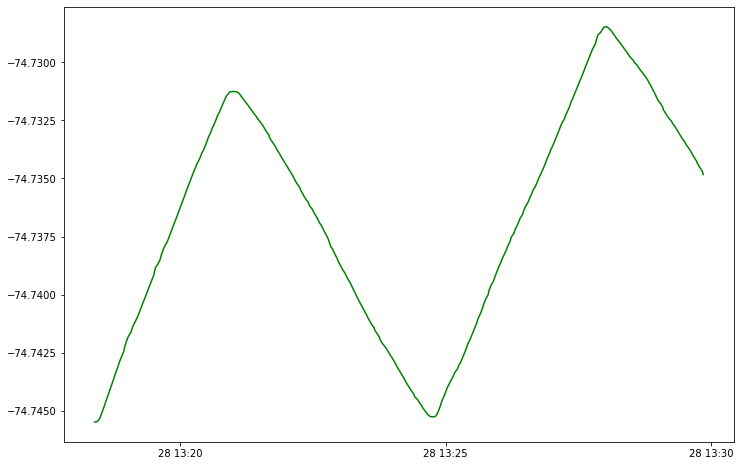

In [74]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='green')
# ax.plot(chla_gdf.time, chla_gdf.sst, color='orange')

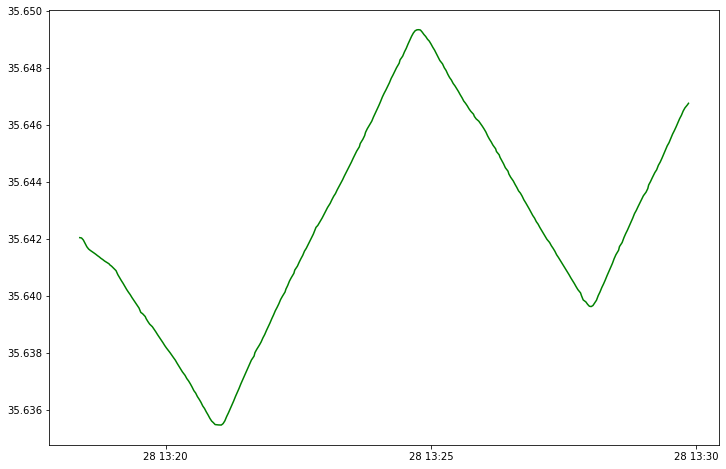

In [75]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Latitude, color='green')
# ax.plot(chla_gdf.time, chla_gdf.sst, color='orange')

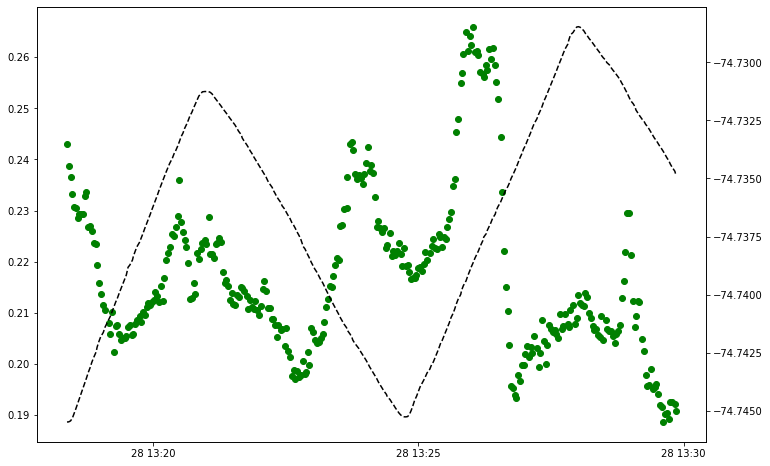

In [76]:
fig, ax = plt.subplots(figsize=(12,8))
ax.scatter(chla_gdf.iloc[:].time, chla_gdf.iloc[:].chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='black', ls='--')


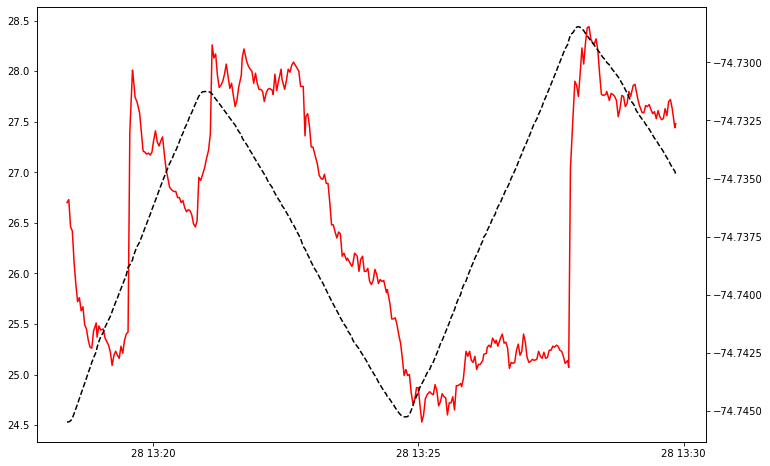

In [77]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].sst, color='red')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='black', ls='--')

<AxesSubplot:>

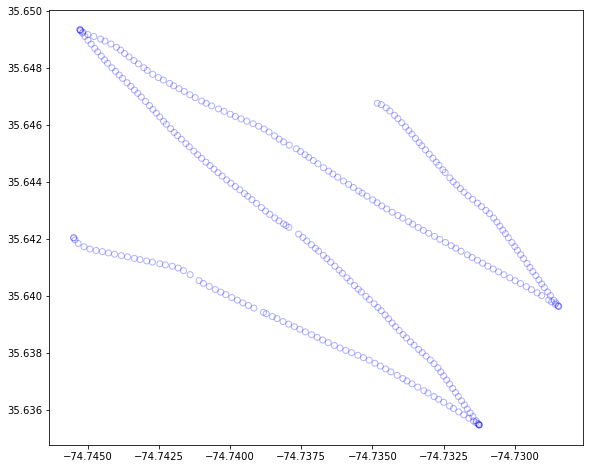

In [78]:
fig, ax = plt.subplots(figsize=(12,8))
chla_gdf.plot(alpha=0.3, ax=ax, facecolor='None', edgecolor='blue')

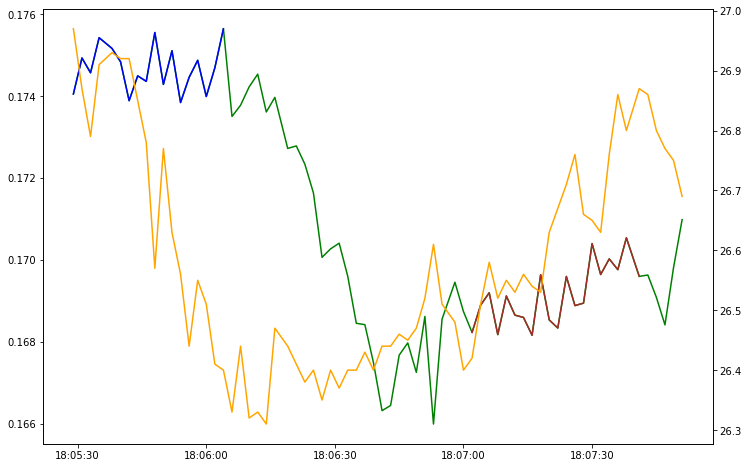

In [265]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].chla, color='green')
ax.plot(chla_gdf.iloc[:18].time, chla_gdf.iloc[:18].chla, color='blue')
ax.plot(chla_gdf.iloc[45:65].time, chla_gdf.iloc[45:65].chla, color='brown')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].sst, color='orange')

In [257]:
len(chla_gdf)

70

<AxesSubplot:>

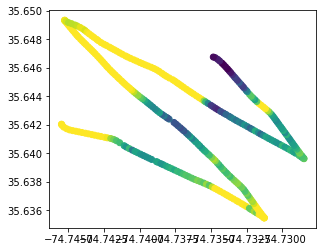

In [94]:
fig, ax = plt.subplots()
chla_gdf.iloc[:].plot('chla',vmin=0.19, vmax=.22, cmap='viridis', ax=ax)
# chla_gdf.iloc[:55].plot('chla',vmin=0.16, vmax=.2, cmap='jet', ax=ax)
# chla_gdf.iloc[55:100].plot('chla',vmin=0.16, vmax=.2, cmap='jet', ax=ax)

<AxesSubplot:>

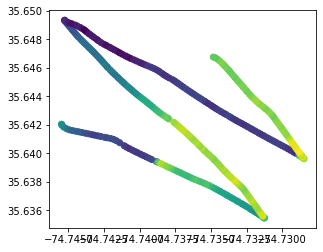

In [84]:
fig, ax = plt.subplots()
chla_gdf.iloc[:].plot('sst', cmap='viridis', ax=ax)
# chla_gdf.iloc[:55].plot('chla',vmin=0.16, vmax=.2, cmap='jet', ax=ax)
# chla_gdf.iloc[55:100].plot('chla',vmin=0.16, vmax=.2, cmap='jet', ax=ax)

In [85]:
chla_gdf['time_str'] = chla_gdf['time'].astype(str)
chla_gdf['lw_spectra'] = chla_gdf['lw_spectra'].astype(str)
chla_gdf.drop('time', 1).to_file('data/oc_analysis_20210828_A1_gulf_stream_surveys.shp')

### Write out the data as .tifs

This step reprojects the data and georegisters it.

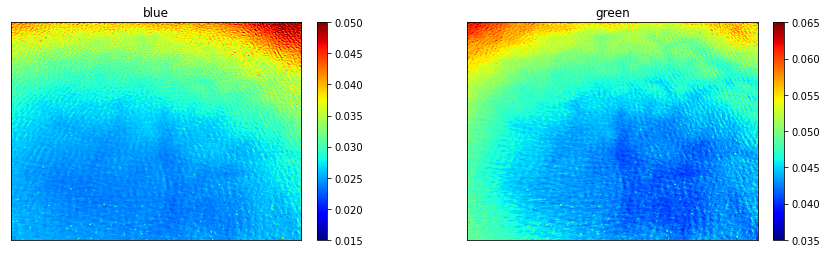

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


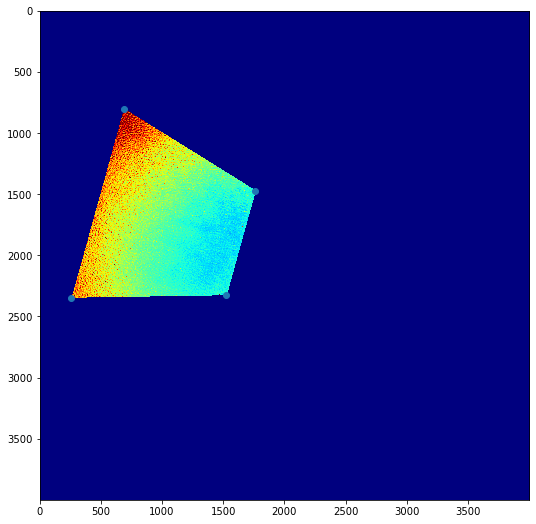

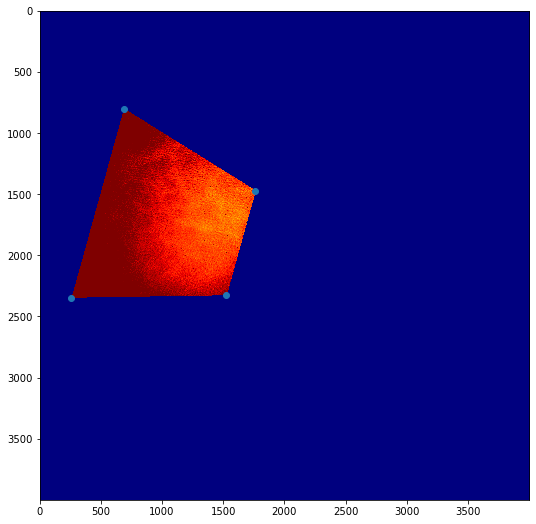

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

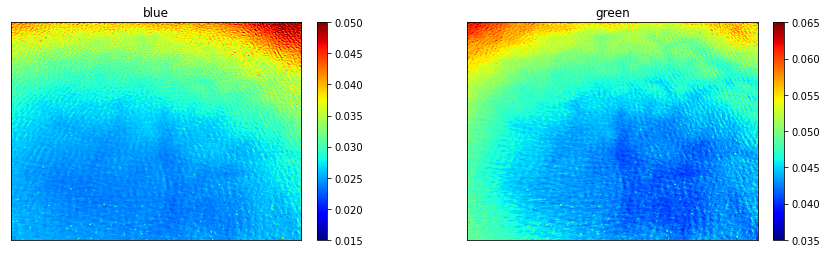

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


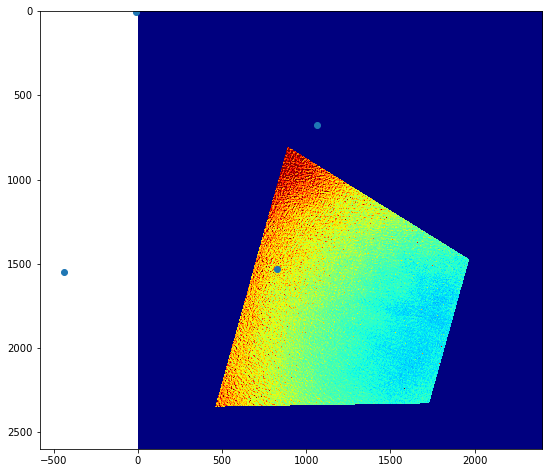

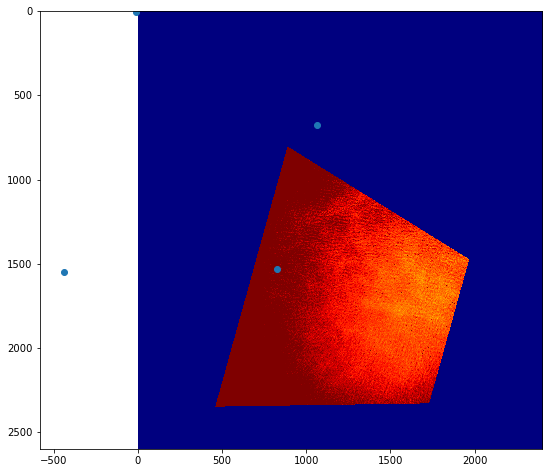

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

## compare this to the Trios Data

If the data exists, otherwise skip or delete this section.

First find the start and stop time of the UAS imagery.

In [159]:
from datetime import datetime
import geopandas as gpd
import pandas as pd

In [160]:
def dms2dd(degrees, minutes, seconds, direction):
    dd = degrees + minutes/60 + seconds/(60*60);
    if direction == 'W' or direction == 'S':
        dd *= -1
    return dd;

In [161]:
ship_df = pd.read_csv('../gs_front_analysis/data/ivan_data/tsg_gps/Navigation/SW-GGA_20210825-082425.Raw', index_col=None,
                 names=['date', 'time','spacer', 'idk', 'SW-GGA-Lat','latdir', 'SW-GGA-Long', 'londir', 'a','b','c','d','e','f','g'])

date_time_strs = ship_df['date'] + ' ' + ship_df['time']

ship_df['datetime'] = [datetime.strptime(x, '%m/%d/%Y %H:%M:%S.%f') for x in date_time_strs]
ship_df['utc_dt'] = ship_df['datetime']+ timedelta(minutes=4)
ship_df  = ship_df.set_index('utc_dt')

ship_df['lon'] = dms2dd(pd.to_numeric(ship_df['SW-GGA-Long'].astype(str).str[:2]).astype(float), pd.to_numeric(ship_df['SW-GGA-Long'].astype(str).str[2:]),np.array(0), 'W')
ship_df['lat'] = dms2dd(pd.to_numeric(ship_df['SW-GGA-Lat'].astype(str).str[:2]).astype(float), pd.to_numeric(ship_df['SW-GGA-Lat'].astype(str).str[2:]),np.array(0), 'E')


ship_gdf = gpd.GeoDataFrame(
    ship_df, geometry=gpd.points_from_xy(ship_df.lon, ship_df.lat))

In [162]:
ship_gdf.head()

,date,time,spacer,idk,SW-GGA-Lat,latdir,SW-GGA-Long,londir,a,b,c,d,e,f,g,datetime,lon,lat,geometry
utc_dt,,,,,,,,,,,,,,,,,,,
2021-08-25 08:28:30.412,08/25/2021,08:24:30.412,$GPGGA,82741.69,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*43,2021-08-25 08:24:30.412,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:31.506,08/25/2021,08:24:31.506,$GPGGA,82742.69,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*40,2021-08-25 08:24:31.506,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:32.287,08/25/2021,08:24:32.287,$GPGGA,82743.70,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*79,2021-08-25 08:24:32.287,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:33.709,08/25/2021,08:24:33.709,$GPGGA,82744.70,3443.0547,N,7640.2342,W,2,29,0.5,-28.5,M,-36.8,M*7F,2021-08-25 08:24:33.709,-76.670570,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:34.631,08/25/2021,08:24:34.631,$GPGGA,82745.70,3443.0547,N,7640.2342,W,2,28,0.5,-28.4,M,-36.8,M*7E,2021-08-25 08:24:34.631,-76.670570,34.717578,POINT (-76.67057 34.71758)


In [163]:
chla_gdf.head(1)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.261675,35.833953,-74.650561,2021-08-27 19:12:11,28.31,"[0.004947081936229893, 0.0014618591288523383, ...",POINT (-74.65056 35.83395)


In [164]:
chla_gdf.tail(1)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
312,0.264029,35.840747,-74.642167,2021-08-27 19:22:50,26.72,"[0.004655954518248785, 0.0013240973509658599, ...",POINT (-74.64217 35.84075)


<AxesSubplot:>

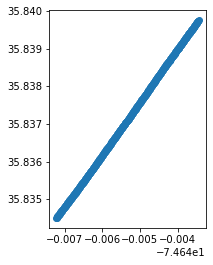

In [165]:
ship_gdf.loc['2021-08-27 19:12:27':'2021-08-27 19:22:47'].plot()

In [166]:
chla_gdf

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.261675,35.833953,-74.650561,2021-08-27 19:12:11,28.31,"[0.004947081936229893, 0.0014618591288523383, ...",POINT (-74.65056 35.83395)
1,0.261908,35.834083,-74.650636,2021-08-27 19:12:13,28.30,"[0.004918104492112574, 0.001450530308899997, 0...",POINT (-74.65064 35.83408)
2,0.263454,35.834228,-74.650719,2021-08-27 19:12:15,28.30,"[0.004909439620141495, 0.001487691927963416, 0...",POINT (-74.65072 35.83423)
3,0.264084,35.834364,-74.650789,2021-08-27 19:12:17,28.18,"[0.004897128759668001, 0.0015127234747191016, ...",POINT (-74.65079 35.83436)
4,0.265750,35.834511,-74.650853,2021-08-27 19:12:19,28.09,"[0.00485700331013789, 0.0015505291800801237, 0...",POINT (-74.65085 35.83451)
...,...,...,...,...,...,...,...
308,0.264309,35.840167,-74.641694,2021-08-27 19:22:42,26.71,"[0.004679080232969265, 0.0013507123942802799, ...",POINT (-74.64169 35.84017)
309,0.264085,35.840303,-74.641800,2021-08-27 19:22:44,26.72,"[0.004680533490109362, 0.001344955804023364, 9...",POINT (-74.64180 35.84030)
310,0.264419,35.840444,-74.641919,2021-08-27 19:22:46,26.73,"[0.004662355789199777, 0.0013374286596416, 8.2...",POINT (-74.64192 35.84044)
311,0.264354,35.840606,-74.642056,2021-08-27 19:22:48,26.70,"[0.0046508962581474035, 0.0013292020167722947,...",POINT (-74.64206 35.84061)


Pull in the trios data based on that day.

In [185]:
trios_fns = [
    '../gs_front_analysis/data/ivan_data/trios/shearwater_trios_20210827.csv',

            ]
trios_dfs = []
for fn in trios_fns:
    trios_dfs.append(pd.read_csv(fn))

trios_df = pd.DataFrame().append(trios_dfs)

Combine the Ship GPS with TriOS based on time

In [186]:
trios_df['datetime'] = pd.to_datetime(trios_df['TimeStamp'])
trios_df['datetime'] = trios_df['datetime'] + timedelta(hours=4)
trios_df['utc_dt'] =trios_df['datetime'] # moving it to UTC
trios_df = trios_df.set_index('utc_dt')

In [187]:
lats = []
lons = []
for i in range(len(trios_df)):
    item = trios_df.iloc[i]
    img_idx = ship_gdf.index.get_loc(item['datetime'], method='nearest')
    lats.append(ship_gdf.iloc[img_idx]['lat'])
    lons.append(ship_gdf.iloc[img_idx]['lon'])

In [188]:
trios_df['lat'] = lats
trios_df['lon'] = lons

<AxesSubplot:>

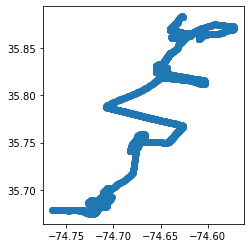

In [189]:
trios_gdf = gpd.GeoDataFrame(
    trios_df, geometry=gpd.points_from_xy(trios_df.lon, trios_df.lat))
trios_gdf.plot()

<AxesSubplot:>

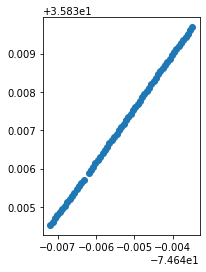

In [190]:
trios_gdf.loc['2021-08-27 19:12:27':'2021-08-27 19:22:47'].plot()

Trim the data to the flight time and closest locations.

In [191]:
chla_gdf.head(1)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.261675,35.833953,-74.650561,2021-08-27 19:12:11,28.31,"[0.004947081936229893, 0.0014618591288523383, ...",POINT (-74.65056 35.83395)


In [192]:
trios_gdf_transect = trios_gdf.loc[chla_gdf.iloc[0]['time']:chla_gdf.iloc[len(chla_gdf)-1]['time']]

In [193]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return(chla_gdf[nearest].Latitude.values[0])

trios_gdf_transect['uas_lat'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return(chla_gdf[nearest].Longitude.values[0])

trios_gdf_transect['uas_lon'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,947,948,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 19:12:20,08/27/2021 15:12:20,0.007479,0.007271,0.007180,0.007087,0.007026,0.006963,0.006922,0.006957,0.007020,...,0.000924,0.000940,0.000922,0.000924,2021-08-27 19:12:20,35.834447,-74.647258,POINT (-74.64726 35.83445),35.833953,-74.650561
2021-08-27 19:12:30,08/27/2021 15:12:30,0.006794,0.006624,0.006555,0.006481,0.006435,0.006386,0.006354,0.006395,0.006461,...,0.000529,0.000546,0.000568,0.000566,2021-08-27 19:12:30,35.834528,-74.647200,POINT (-74.64720 35.83453),35.833953,-74.650561


In [194]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return chla_gdf[nearest].lw_spectra.values[0]

trios_gdf_transect['uas_spec'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,948,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 19:12:20,08/27/2021 15:12:20,0.007479,0.007271,0.007180,0.007087,0.007026,0.006963,0.006922,0.006957,0.007020,...,0.000940,0.000922,0.000924,2021-08-27 19:12:20,35.834447,-74.647258,POINT (-74.64726 35.83445),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ..."
2021-08-27 19:12:30,08/27/2021 15:12:30,0.006794,0.006624,0.006555,0.006481,0.006435,0.006386,0.006354,0.006395,0.006461,...,0.000546,0.000568,0.000566,2021-08-27 19:12:30,35.834528,-74.647200,POINT (-74.64720 35.83453),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ..."


In [195]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return chla_gdf[nearest].chla.values[0]

trios_gdf_transect['uas_chla'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 19:12:20,08/27/2021 15:12:20,0.007479,0.007271,0.007180,0.007087,0.007026,0.006963,0.006922,0.006957,0.007020,...,0.000922,0.000924,2021-08-27 19:12:20,35.834447,-74.647258,POINT (-74.64726 35.83445),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675
2021-08-27 19:12:30,08/27/2021 15:12:30,0.006794,0.006624,0.006555,0.006481,0.006435,0.006386,0.006354,0.006395,0.006461,...,0.000568,0.000566,2021-08-27 19:12:30,35.834528,-74.647200,POINT (-74.64720 35.83453),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675


In [196]:
import geopy.distance
def dist_fcn(sample_lat,sample_lon,uas_lat,uas_lon):
    coords_1 = (sample_lat, sample_lon)
    coords_2 = (uas_lat, uas_lon)
    return(geopy.distance.distance(coords_1, coords_2).km)
trios_gdf_transect['pt_dist'] = trios_gdf_transect.apply(lambda row: dist_fcn(row['lat'],row['lon'],row['uas_lat'],row['uas_lon']), axis=1)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


(array([ 9.,  6.,  8., 10.,  9.,  4.,  3.,  5.,  5.,  4.]),
 array([0.00749447, 0.04485474, 0.082215  , 0.11957526, 0.15693553,
        0.19429579, 0.23165606, 0.26901632, 0.30637658, 0.34373685,
        0.38109711]),
 <BarContainer object of 10 artists>)

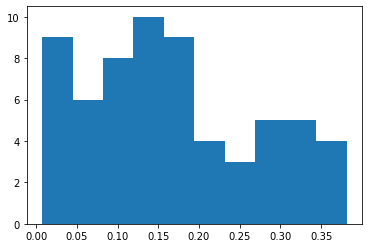

In [197]:
plt.hist(trios_gdf_transect.pt_dist)

In [198]:
matched_subset = trios_gdf_transect[trios_gdf_transect.pt_dist < 0.8]
len(matched_subset)

63

In [246]:
matched_subset

,TimeStamp,320,321,322,323,324,325,326,327,328,...,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla,pt_dist,chla_oci
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 19:12:20,08/27/2021 15:12:20,0.007479,0.007271,0.007180,0.007087,0.007026,0.006963,0.006922,0.006957,0.007020,...,2021-08-27 19:12:20,35.834447,-74.647258,POINT (-74.64726 35.83445),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675,0.303403,0.268125
2021-08-27 19:12:30,08/27/2021 15:12:30,0.006794,0.006624,0.006555,0.006481,0.006435,0.006386,0.006354,0.006395,0.006461,...,2021-08-27 19:12:30,35.834528,-74.647200,POINT (-74.64720 35.83453),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675,0.310325,0.268076
2021-08-27 19:12:40,08/27/2021 15:12:40,0.006335,0.006154,0.006075,0.006019,0.005989,0.005954,0.005918,0.005948,0.006006,...,2021-08-27 19:12:40,35.834615,-74.647135,POINT (-74.64714 35.83461),35.838042,-74.646847,"[0.004971140753339473, 0.0015289357786372687, ...",0.263435,0.381097,0.269712
2021-08-27 19:12:50,08/27/2021 15:12:50,0.006648,0.006451,0.006366,0.006307,0.006274,0.006235,0.006205,0.006246,0.006313,...,2021-08-27 19:12:50,35.834698,-74.647078,POINT (-74.64708 35.83470),35.838042,-74.646847,"[0.004971140753339473, 0.0015289357786372687, ...",0.263435,0.371550,0.270984
2021-08-27 19:13:00,08/27/2021 15:13:00,0.006334,0.006177,0.006117,0.006050,0.006010,0.005967,0.005946,0.005999,0.006076,...,2021-08-27 19:13:00,35.834782,-74.647007,POINT (-74.64701 35.83478),35.838042,-74.646847,"[0.004971140753339473, 0.0015289357786372687, ...",0.263435,0.362003,0.267762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-27 19:22:10,08/27/2021 15:22:10,0.007942,0.007723,0.007626,0.007513,0.007435,0.007357,0.007317,0.007359,0.007427,...,2021-08-27 19:22:10,35.839443,-74.643665,POINT (-74.64366 35.83944),35.837722,-74.644172,"[0.004891369876663198, 0.0014079083538698133, ...",0.261380,0.196389,0.266799
2021-08-27 19:22:20,08/27/2021 15:22:20,0.006249,0.006058,0.005972,0.005918,0.005891,0.005860,0.005845,0.005897,0.005973,...,2021-08-27 19:22:20,35.839523,-74.643607,POINT (-74.64361 35.83952),35.840817,-74.642494,"[0.004694390673480814, 0.0013726166154672797, ...",0.264630,0.175186,0.268454
2021-08-27 19:22:30,08/27/2021 15:22:30,0.008641,0.008459,0.008392,0.008257,0.008160,0.008068,0.008042,0.008105,0.008191,...,2021-08-27 19:22:30,35.839603,-74.643552,POINT (-74.64355 35.83960),35.840817,-74.642494,"[0.004694390673480814, 0.0013726166154672797, ...",0.264630,0.165068,0.266898


In [201]:
plt.rcParams.update({'font.size': 14})

In [236]:
matched_subset.iloc[i, 156:161].mean()

0.00700798636

(0.001, 0.008)

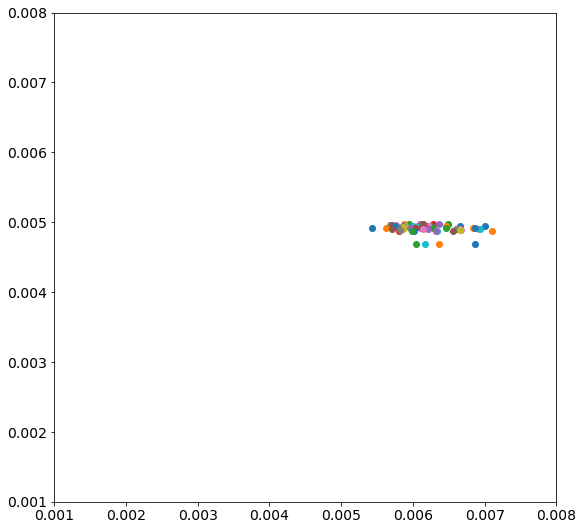

In [245]:
fig,ax = plt.subplots(figsize=(9,9))
for i in range(len(matched_subset)):
    ax.scatter(matched_subset.iloc[i, 156:161].mean(),matched_subset.iloc[i].uas_spec[0])
#     ax.plot(matched_subset.columns[1:-11].astype(int),matched_subset.iloc[i,1:-11], color='green', alpha=0.3)
#     ax.plot([475, 560, 668, 717, 842],matched_subset.iloc[i].uas_spec, color='red', alpha=0.2)
ax.set_xlim(0.001,0.008)
ax.set_ylim(0.001,0.008)
# ax.set_ylabel('Remote sensing reflectance (Rrs)')
# ax.set_xlabel('Wavelength (nm)')
# fig.savefig('comparing_trios_to_altum.png',dpi=300)

In [2]:
matched_subset

NameError: name 'matched_subset' is not defined

Text(0.5, 0, 'Wavelength (nm)')

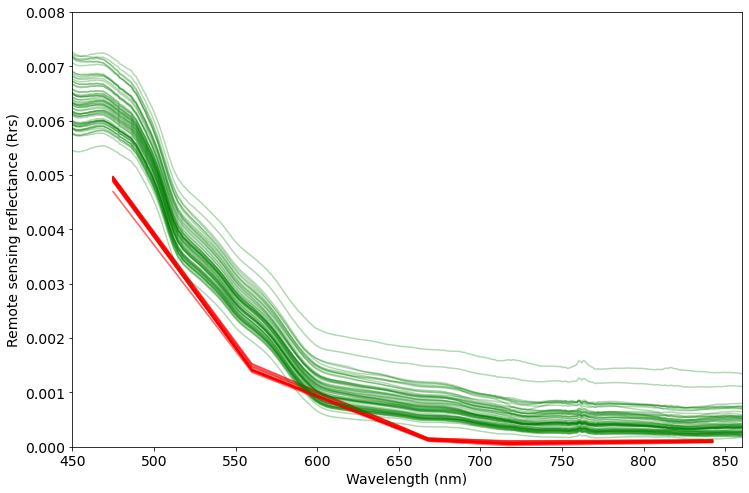

In [205]:
fig,ax = plt.subplots(figsize=(12,8))
for i in range(len(matched_subset)):
    ax.plot(matched_subset.columns[1:-11].astype(int),matched_subset.iloc[i,1:-11], color='green', alpha=0.3)
    ax.plot([475, 560, 668, 717, 842],matched_subset.iloc[i].uas_spec, color='red', alpha=0.2)
ax.set_xlim(450,860)
ax.set_ylim(0,0.008)
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Wavelength (nm)')
# fig.savefig('comparing_trios_to_altum.png',dpi=300)

In [203]:
matched_subset['chla_oci'] = oc_index(matched_subset.iloc[:, 156:161].mean(axis=1).values, matched_subset.iloc[:, 232:240].mean(axis=1).values, matched_subset.iloc[:, 346:351].mean(axis=1).values)

In [215]:
matched_subset

,TimeStamp,320,321,322,323,324,325,326,327,328,...,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla,pt_dist,chla_oci
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 19:12:20,08/27/2021 15:12:20,0.007479,0.007271,0.007180,0.007087,0.007026,0.006963,0.006922,0.006957,0.007020,...,2021-08-27 19:12:20,35.834447,-74.647258,POINT (-74.64726 35.83445),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675,0.303403,0.268125
2021-08-27 19:12:30,08/27/2021 15:12:30,0.006794,0.006624,0.006555,0.006481,0.006435,0.006386,0.006354,0.006395,0.006461,...,2021-08-27 19:12:30,35.834528,-74.647200,POINT (-74.64720 35.83453),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675,0.310325,0.268076
2021-08-27 19:12:40,08/27/2021 15:12:40,0.006335,0.006154,0.006075,0.006019,0.005989,0.005954,0.005918,0.005948,0.006006,...,2021-08-27 19:12:40,35.834615,-74.647135,POINT (-74.64714 35.83461),35.838042,-74.646847,"[0.004971140753339473, 0.0015289357786372687, ...",0.263435,0.381097,0.269712
2021-08-27 19:12:50,08/27/2021 15:12:50,0.006648,0.006451,0.006366,0.006307,0.006274,0.006235,0.006205,0.006246,0.006313,...,2021-08-27 19:12:50,35.834698,-74.647078,POINT (-74.64708 35.83470),35.838042,-74.646847,"[0.004971140753339473, 0.0015289357786372687, ...",0.263435,0.371550,0.270984
2021-08-27 19:13:00,08/27/2021 15:13:00,0.006334,0.006177,0.006117,0.006050,0.006010,0.005967,0.005946,0.005999,0.006076,...,2021-08-27 19:13:00,35.834782,-74.647007,POINT (-74.64701 35.83478),35.838042,-74.646847,"[0.004971140753339473, 0.0015289357786372687, ...",0.263435,0.362003,0.267762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-27 19:22:10,08/27/2021 15:22:10,0.007942,0.007723,0.007626,0.007513,0.007435,0.007357,0.007317,0.007359,0.007427,...,2021-08-27 19:22:10,35.839443,-74.643665,POINT (-74.64366 35.83944),35.837722,-74.644172,"[0.004891369876663198, 0.0014079083538698133, ...",0.261380,0.196389,0.266799
2021-08-27 19:22:20,08/27/2021 15:22:20,0.006249,0.006058,0.005972,0.005918,0.005891,0.005860,0.005845,0.005897,0.005973,...,2021-08-27 19:22:20,35.839523,-74.643607,POINT (-74.64361 35.83952),35.840817,-74.642494,"[0.004694390673480814, 0.0013726166154672797, ...",0.264630,0.175186,0.268454
2021-08-27 19:22:30,08/27/2021 15:22:30,0.008641,0.008459,0.008392,0.008257,0.008160,0.008068,0.008042,0.008105,0.008191,...,2021-08-27 19:22:30,35.839603,-74.643552,POINT (-74.64355 35.83960),35.840817,-74.642494,"[0.004694390673480814, 0.0013726166154672797, ...",0.264630,0.165068,0.266898


(0.0, 0.3)

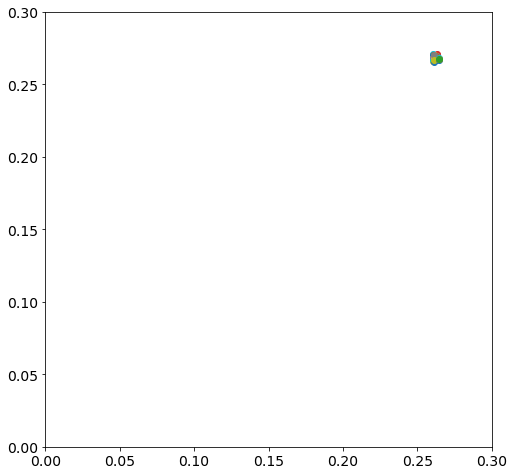

In [204]:
fig, ax = plt.subplots(figsize=(8,8))
for i in range(len(matched_subset)):
    plt.scatter(matched_subset.iloc[i].uas_chla, matched_subset.iloc[i].chla_oci)
plt.xlim(0,.3)
plt.ylim(0,.3)

In [206]:
(matched_subset.iloc[i].uas_chla, matched_subset.iloc[i].chla_oci)

(0.2646304699100481, 0.26785175625965535)

In [251]:
chla_gdf.head(2)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry,time_str
0,0.261675,35.833953,-74.650561,2021-08-27 19:12:11,28.31,[0.00494708 0.00146186 0.00015672 0.00010715 0...,POINT (-74.65056 35.83395),2021-08-27 19:12:11
1,0.261908,35.834083,-74.650636,2021-08-27 19:12:13,28.30,[4.91810449e-03 1.45053031e-03 1.53388742e-04 ...,POINT (-74.65064 35.83408),2021-08-27 19:12:13


In [249]:
matched_subset.head(2)

,TimeStamp,320,321,322,323,324,325,326,327,328,...,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla,pt_dist,chla_oci
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 19:12:20,08/27/2021 15:12:20,0.007479,0.007271,0.007180,0.007087,0.007026,0.006963,0.006922,0.006957,0.007020,...,2021-08-27 19:12:20,35.834447,-74.647258,POINT (-74.64726 35.83445),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675,0.303403,0.268125
2021-08-27 19:12:30,08/27/2021 15:12:30,0.006794,0.006624,0.006555,0.006481,0.006435,0.006386,0.006354,0.006395,0.006461,...,2021-08-27 19:12:30,35.834528,-74.647200,POINT (-74.64720 35.83453),35.833953,-74.650561,"[0.004947081936229893, 0.0014618591288523383, ...",0.261675,0.310325,0.268076


In [ ]:
cgdf_copy = chla_gdf.copy()
cgdf_copy['time_str'] = cgdf_copy['time'].astype(str)
cgdf_copy['lw_spectra'] = cgdf_copy['lw_spectra'].astype(str)
cgdf_copy.drop('time', 1).to_file('data/oc_analysis_20210827_A2_gulf_stream_surveys.shp')

In [ ]:
mgdf_copy = matched_subset.copy()

mgdf_copy['time_str'] = mgdf_copy['datetime'].astype(str)
mgdf_copy['uas_spec'] = mgdf_copy['uas_spec'].astype(str)
mgdf_copy.drop('datetime', 1).to_file('data/oc_analysis_20210827_A2_gulf_stream_surveys_matched_df.shp', index=False)